# Information Demand and market volatility

In [1]:
from pytrends.request import TrendReq
import pandas_datareader as pdr
import pandas as pd
import pandas_datareader.data as web
import pandas as pd
import numpy as np

from datetime import date
import datetime
import time

import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import statsmodels.tsa.stattools as ts
import statsmodels.tsa.arima_model as am
from statsmodels.tsa.api import VAR, DynamicVAR, VARMAX
from statsmodels.stats.diagnostic import *
from statsmodels.stats.stattools import *
import scipy.stats as scs
import scipy
import arch

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

# Subjects of study

In this work we will use the 30 stocks that conform the Dow Jones index. These are the following:

In [2]:
series = {'MMM':'3M',
'AXP':'American Express',
'AAPL':'Apple',
'BA':'Boeing',
'CAT':'Caterpillar',
'CVX':'Chevron',
'CSCO':'Cisco',
'KO':'Coca-Cola',
'DIS':'Disney',
'XOM':'Exxon Mobil',
'GE':'General Electric',
'GS':'Goldman Sachs',
'HD':'Home Depot',
'IBM':'IBM',
'INTC':'Intel',
'JNJ':'Johnson & Johnson',
'JPM':'JPMorgan Chase',
'MCD':'McDonald\'s',
'MRK':'Merck',
'MSFT':'Microsoft',
'NKE':'Nike',
'PFE':'Pfizer',
'PG':'Procter & Gamble',
'TRV':'Travelers Companies Inc',
'UTX':'United Technologies',
'UNH':'UnitedHealth',
'VZ':'Verizon',
'V':'Visa',
'WMT':'Wal-Mart',
'^DJI':'Dow Jones',
'SPY':'s&p500'}

In [3]:
####################################
# Nasda1 100 companies
####################################
# Read
df_companies_NQ = pd.read_csv('./data/nasdaq-companies.csv', sep=';', encoding='latin-1')
# Select top 100
df_companies_NQ = df_companies_NQ.sort_values(by = 'MarketCap', ascending=False).head(111)
# Preprocess
df_companies_NQ['Name'] = df_companies_NQ['Name'].map(lambda x: x.replace('.com','')
                                                      .replace('.','')
                                                      .replace(',','')
                                                      .replace('Incorporated','')
                                                      .replace('Corporation','')
                                                      .replace('Public Limited Company','')
                                                      .replace('Ltd','')
                                                      .replace('plc','')
                                                      .replace('Inc','')
                                                      .replace('O&#39;',"O'")
                                                      .replace('!','')
                                                      .strip())
df_companies_NQ.drop_duplicates(subset = 'Name', inplace = True)

# Fix special cases
df_companies_NQ.loc[df_companies_NQ.Symbol == 'PCLN','Name'] = 'Booking'
df_companies_NQ.loc[df_companies_NQ.Symbol == 'PCLN','Symbol'] = 'BKNG'
df_companies_NQ = df_companies_NQ[~df_companies_NQ.Symbol.isin(['YHOO','ESRX','SHPG','FOX','CA'])]

# To dict
series = dict(zip(df_companies_NQ.Symbol.values, df_companies_NQ.Name.values))
series['SPY'] = 's&p500'

In [4]:
# Keep industries
sectors_dict = dict(zip(df_companies_NQ.Symbol.values, df_companies_NQ.Sector))

Plotting function

In [5]:
def tsplot(y, lags=None, figsize=(10, 8), style='bmh', title = 'Time Series', time_id = 'date' ):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        pp_ax = plt.subplot2grid(layout, (2, 1))
        
        ts_ax.plot(time_id, y)
        ts_ax.set_title(title+' Analysis Plots')
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.5)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)
        sm.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')        
        scs.probplot(y, sparams=(y.mean(), y.std()), plot=pp_ax)

        plt.tight_layout()
    return

# Information demand

The information demand will be retreived as the SVI index taken from Google Trends. For that, we call the pytrends API

https://github.com/GeneralMills/pytrends#common-api-parameters

The data obtained has a monthly frequency. We keep the S&P500 index as the market meassure for information demand. 

In [7]:
##########################################
# Google trends API data retreival
##########################################
def get_SVI(term):
    ''' Get SVI for a given term on Google Trends '''
    count = 1
    
    while True:
        print(term)
        time.sleep(2)
        term = term.lower()
        pytrends = TrendReq(hl='en')

        pytrends.build_payload([term], # Terminos de busqueda
                                       cat=0, # category to narrow result
                                       timeframe='all'
                                      )
        # Get time series for term
        df = pytrends.interest_over_time()

        # Filter finished days
        df['isPartial'] = df['isPartial'].map(lambda x: x == 'False')
        df = df[df['isPartial']]
        df = df[term]

        if len(df) > 0:
            break
                
    return df
  
search_terms = list(series.values())
data = list(map(get_SVI,search_terms ))

Apple
Alphabet
Microsoft
Facebook
Amazon
Comcast
Cisco Systems
Intel
Amgen
The Kraft Heinz Company
Charter Communications
Celgene
Walgreens Boots Alliance
Gilead Sciences
Broadcom Limited
Booking
QUALCOMM
Starbucks
Texas Instruments
Costco Wholesale
Mondelez International
NVIDIA
Adobe Systems
Netflix
Biogen
T-Mobile US
PayPal Holdings
Automatic Data Processing
Baidu
America Movil SAB de CV
PowerShares QQQ Trust Series 1
CSX
Tesla
Applied Materials
CME Group
Regeneron Pharmaceuticals
Activision Blizzard
eBay
Marriott International
Cognizant Technology Solutions
NXP Semiconductors NV
Liberty Global
Micron Technology
Intuit
Equinix
Analog Devices
DISH Network
JD
yte
Intuitive Surgical
Electronic Arts
Alexion Pharmaceuticals
Monster Beverage
Ross Stores
Illumina
O'Reilly Automotive
Fiserv
Sirius XM Holdings
PACCAR
Western Digital
Vertex Pharmaceuticals
Paychex
Mylan NV
NetEase
Huntington Bancshares
American Airlines Group
Lam Research
Ctrip International
TD Ameritrade Holding
Northern Trus

In [8]:
###############################
# Process extracted data 
###############################
# Stack --------------------
SVI_df = pd.concat(data, keys=search_terms, names=['Ticker', 'Date'])
SVI_df = SVI_df.unstack('Ticker').reset_index()

# Take logs ------------------------------------
SVI_df = SVI_df.set_index('Date')
SVI_df = np.log(SVI_df + 1)
SVI_df = SVI_df.reset_index()

# Interpolate missing dates ---------------------------------
def interpolate_days(x):
    x = x.sort_values('Date')
    return(x.interpolate(method='quadratic'))
    
SVI_df = SVI_df.set_index('Date').stack().reset_index()
SVI_df = SVI_df.set_index('Date').groupby(['Ticker']).resample('M').last().drop(columns = ['Ticker']).reset_index()

SVI_df = SVI_df.groupby(['Ticker']).apply(interpolate_days)
SVI_df = SVI_df.reset_index(drop = True)
SVI_df.columns = ['Ticker','Date','SVI']
SVI_df = SVI_df.pivot(index='Date',values='SVI',columns='Ticker').reset_index()

# Stack time series
SVI_df = SVI_df.set_index('Date').stack('Ticker').reset_index()

# Keep market data -----------------------
s = 's&p500'
info_df = SVI_df.query('Ticker != @s').rename(columns = {0:'SVI'})
m_info_df = SVI_df.query('Ticker == @s').drop(columns = ['Ticker']).rename(columns = {0:'market_info'})
info_df = pd.merge(info_df, m_info_df, on='Date')

# Keep descriptive statistics -----------------------------------
DF_df = SVI_df.drop(columns = ['Date']).groupby('Ticker').aggregate([np.max, np.min,np.mean, np.median, np.std, scs.skew, scs.kurtosis, lambda x: scs.jarque_bera(x)[1] ]).reset_index()
DF_df.round(decimals = 2).to_csv('./data/descriptive.csv')

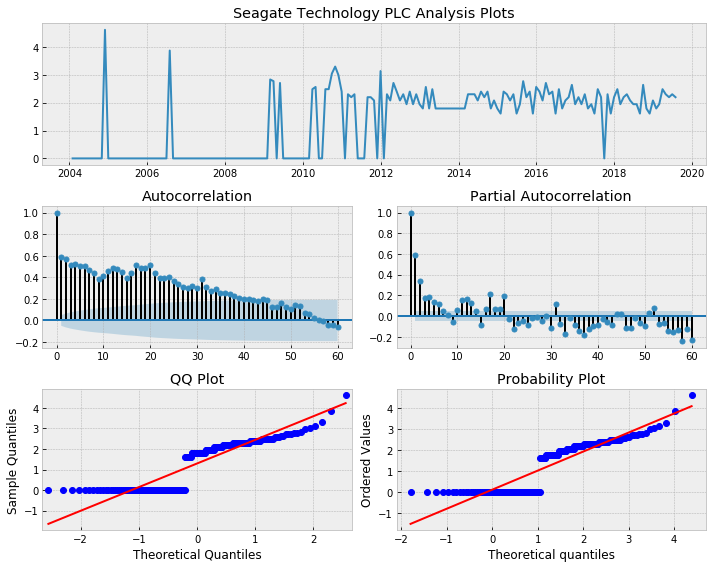

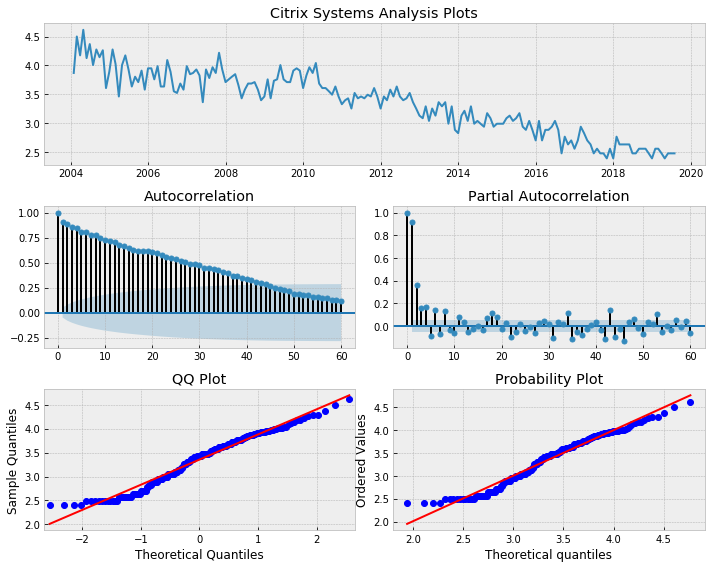

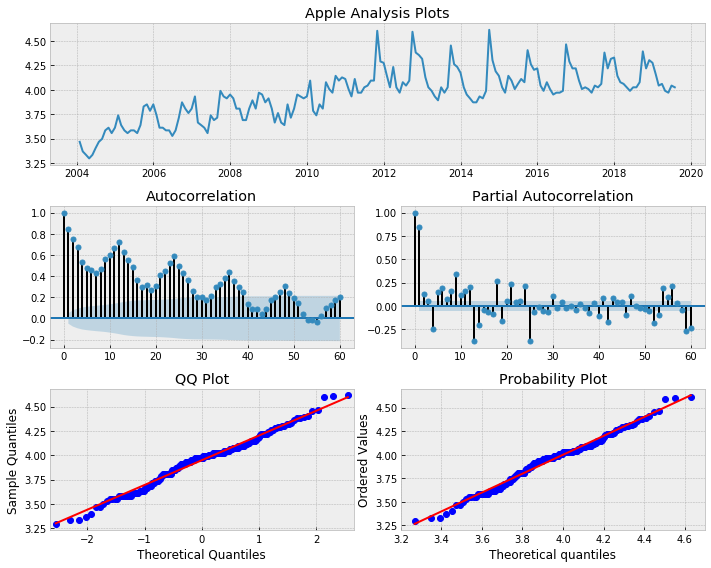

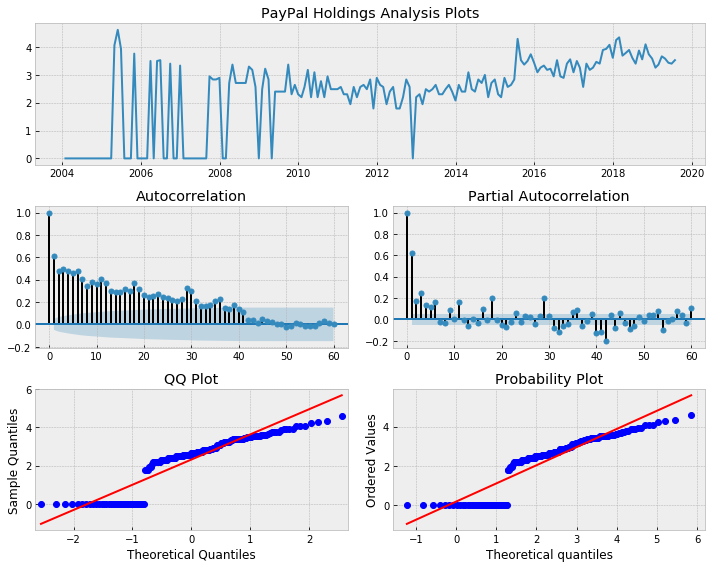

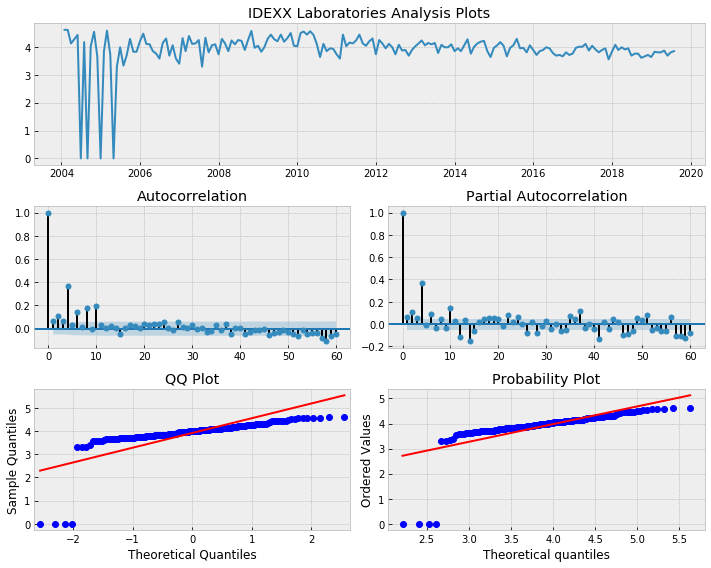

...

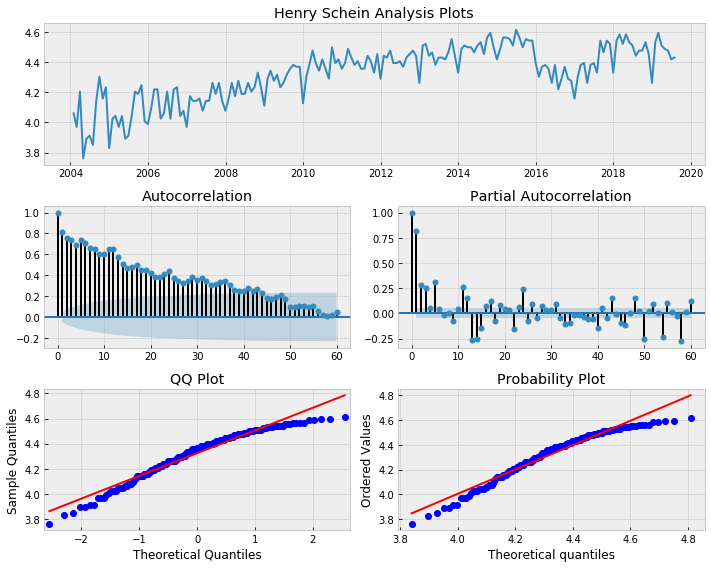

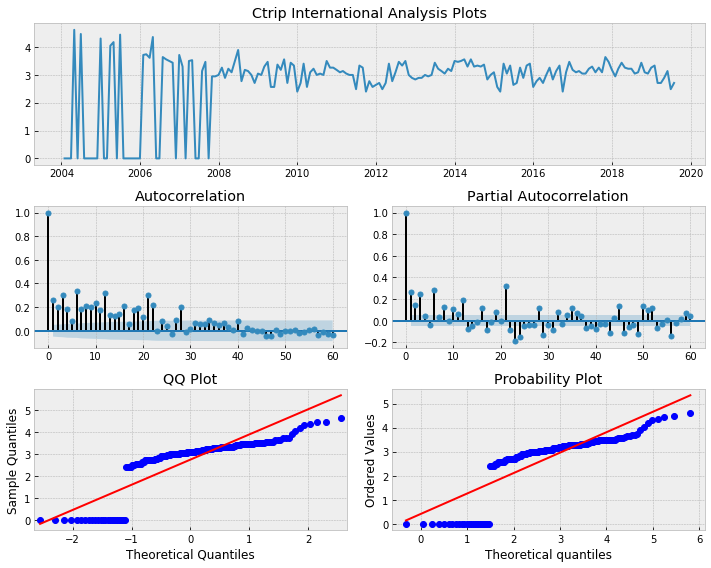

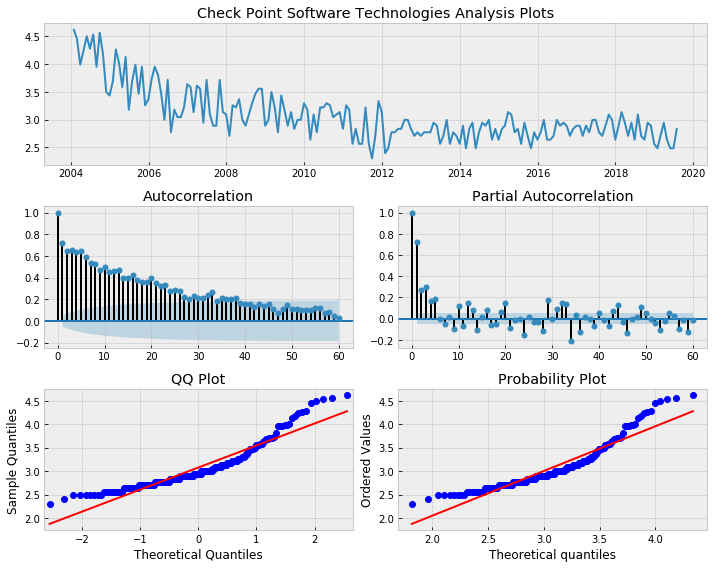

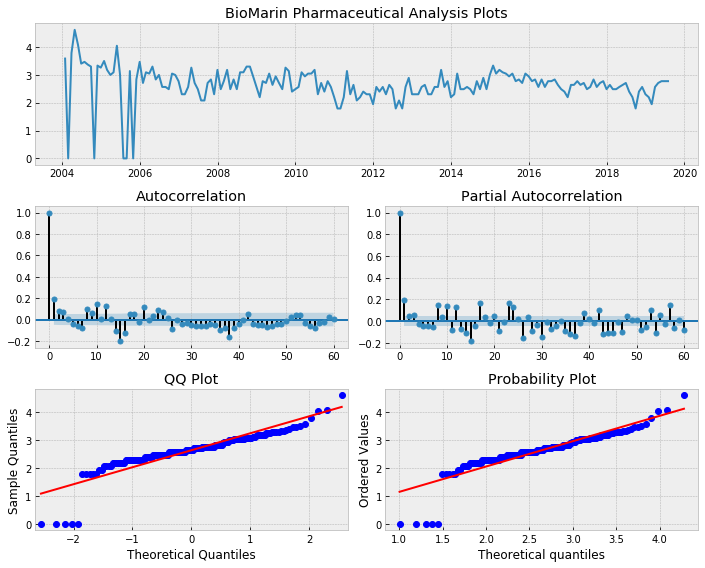

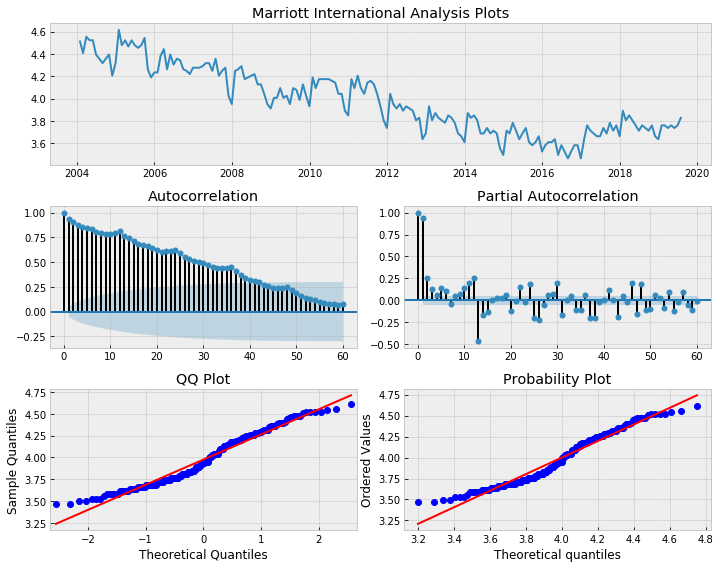

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1283: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


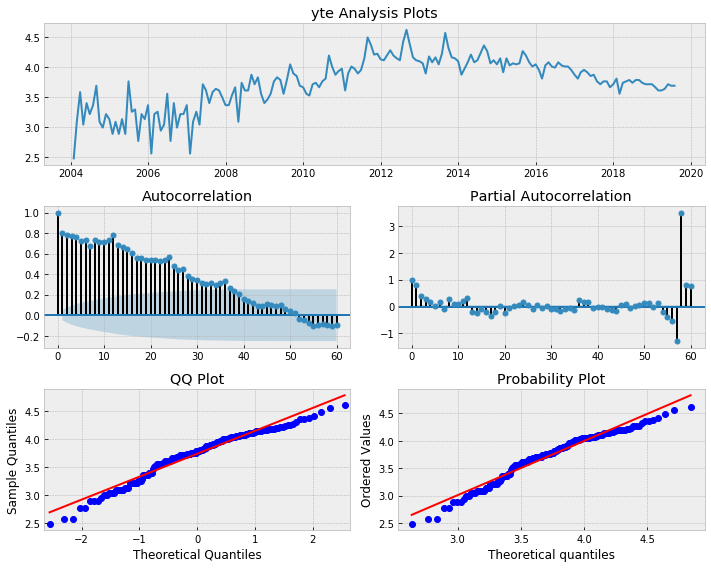

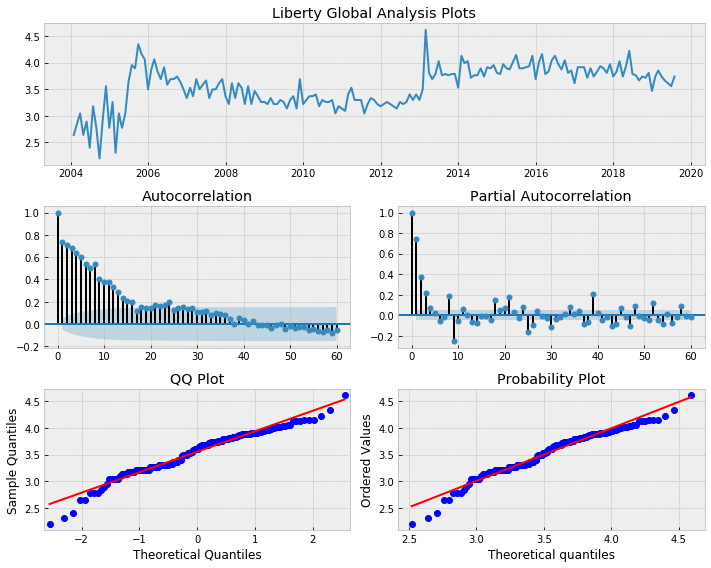

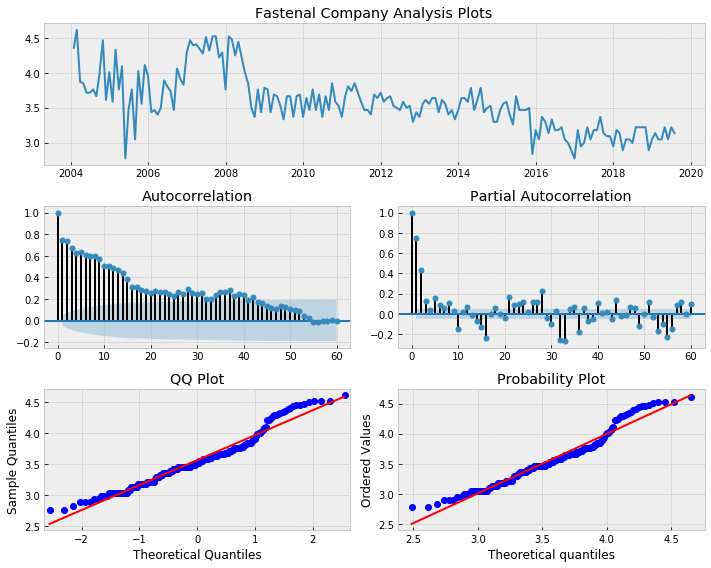

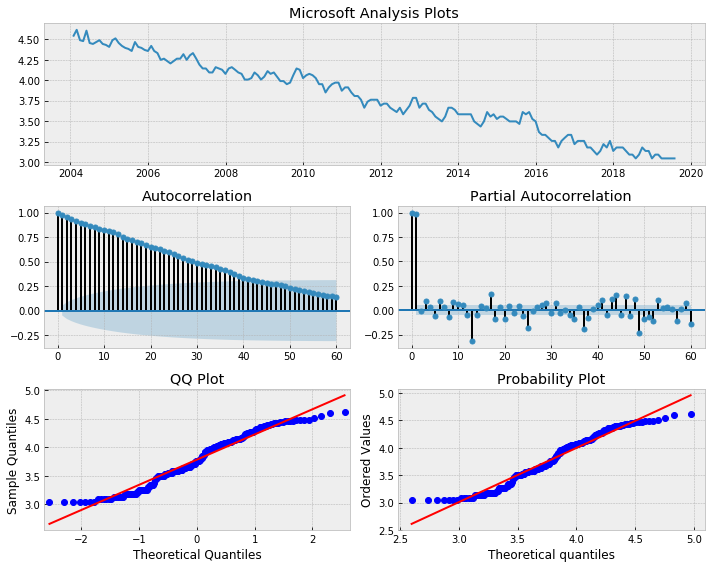

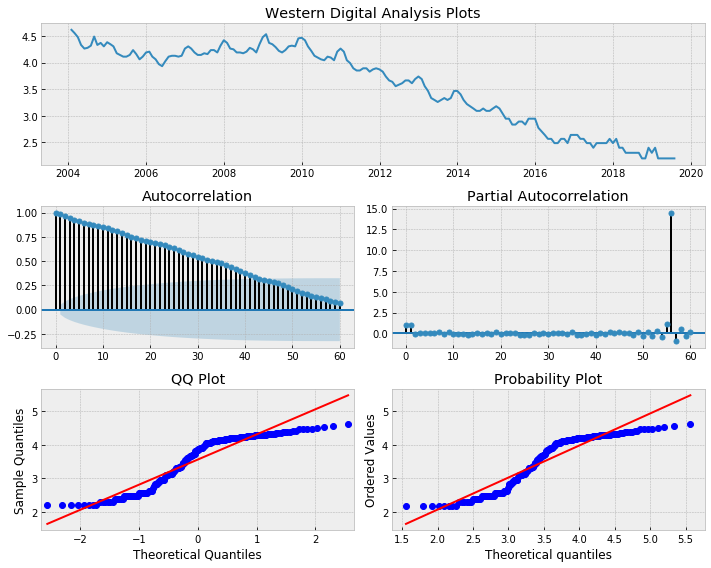

...

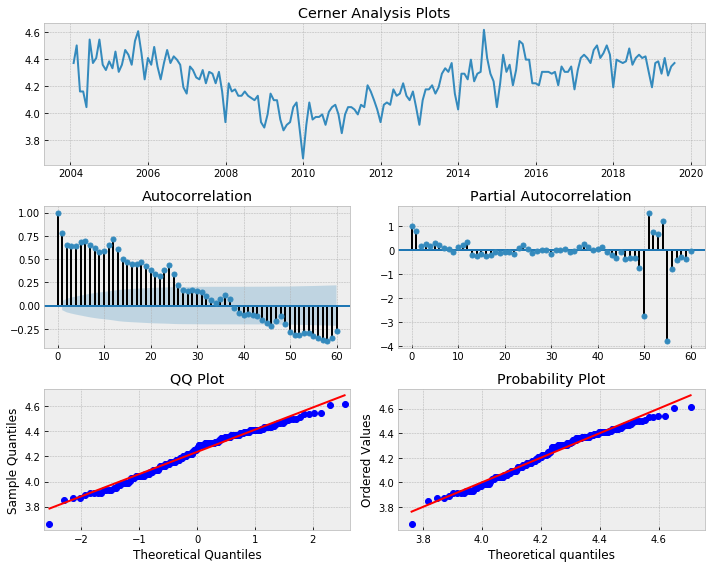

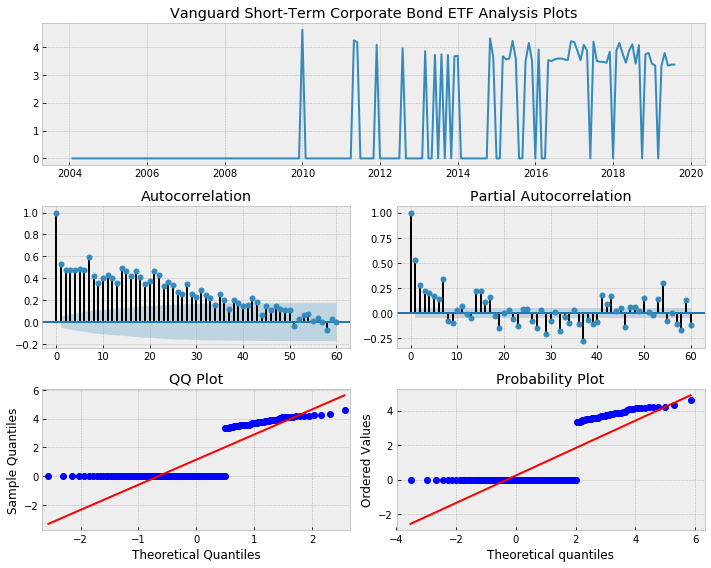

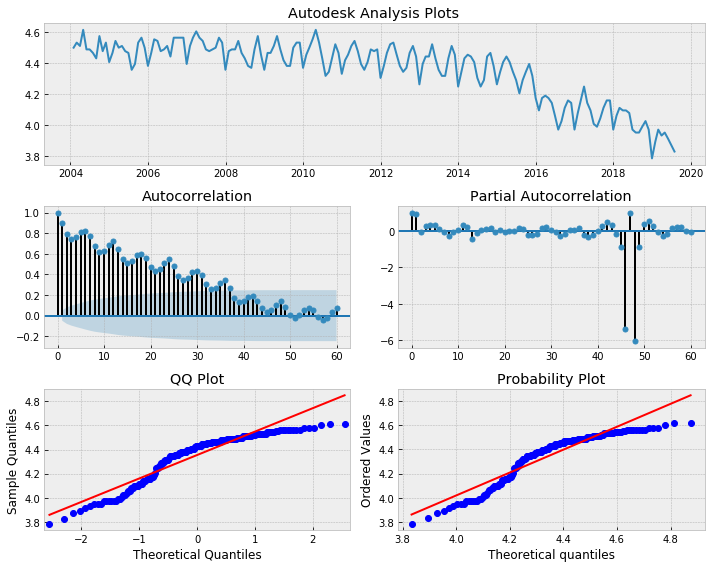

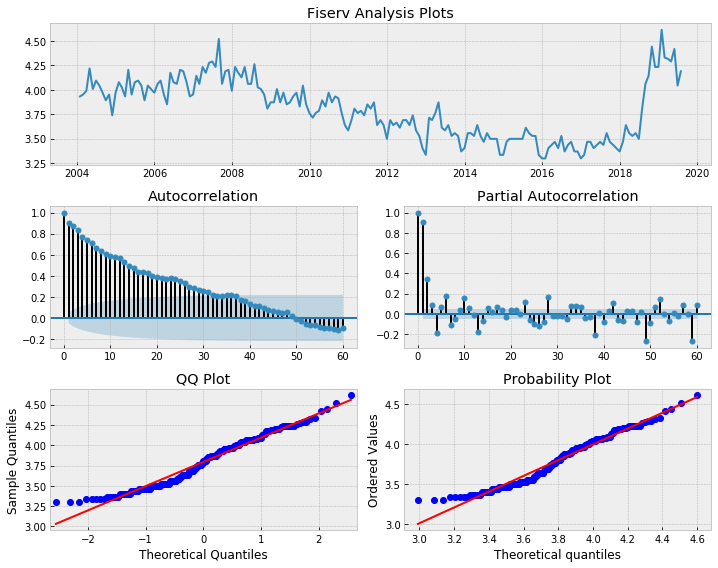

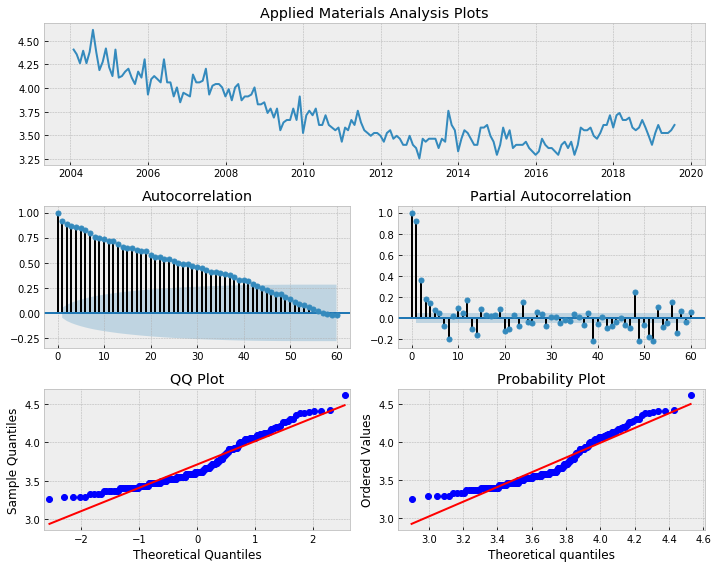

In [9]:
info_df_T = info_df.pivot(columns = 'Ticker', index = 'Date', values = 'SVI')

values = list(set(series.values()) - set(['s&p500']))
for i in values:
    tsplot(y = info_df_T[i], title = i, time_id = info_df_T.reset_index()['Date'], lags = 60)
    plt.show()

## Stationarity tests

We perform 2 stationarity tests: 


*   Augmented Dickey–Fuller test

    https://en.wikipedia.org/wiki/Augmented_Dickey%E2%80%93Fuller_test
    
    Testing for the null hypothesis that a unit root is present in a time series.
    
    http://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.adfuller.html
        
    
*   Kwiatkowski-Phillips-Schmidt-Shin test for stationarity
   
    https://en.wikipedia.org/wiki/KPSS_test
    
    Testing for the null hypothesis that an observable time series is stationary around a deterministic level or trend (i.e. trend-stationary) against the alternative of a unit root.
    
    http://www.statsmodels.org/dev/generated/statsmodels.tsa.stattools.kpss.html
    

In [10]:
''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x, regression = 'c')[1]

  
def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct')[1]


DF_df = info_df.drop(columns = ['Date','market_info']).groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
DF_df.round(decimals = 2)

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users

SVI                       \
                                       df_test_ct df_test_c df_test_nc   
Ticker                                                                   
Activision Blizzard                          0.70      0.48       0.81   
Adobe Systems                                0.14      0.90       0.01   
Alexion Pharmaceuticals                      0.00      0.42       0.67   
Alphabet                                     0.59      0.07       0.31   
Amazon                                       0.62      0.80       0.98   
America Movil SAB de CV                      0.83      0.31       0.74   
American Airlines Group                      0.00      0.00       0.61   
Amgen                                        0.94      0.71       0.04   
Analog Devices                               1.00      0.20       0.04   
Apple                                        0.84      0.21       0.97   
Applied Materials                            0.94      0.15       0.13   
Autodesk                                     0.98      1.00       0.07   
Automatic Data Processing                    0.45      0.20       0.00   
Baidu                                        0.04      0.65       0.34   
BioMarin Pharmaceutical                      0.00      0.00       0.47   
Biogen                                       0.64      0.06       0.06   
Booking                                      0.52      0.52       0.96   
Broadcom Limited                             0.02      0.01       0.66   
CME Group                                    0.66      0.26       0.73   
CSX                                          0.01      0.16       0.54   
Celgene                                      0.38      0.56       0.95   
Cerner                                       0.48      0.32       0.55   
Charter Communications                       0.19      0.98       0.03   
Check Point Software Technologies            0.04      0.00       0.01   
Cintas                                       0.63      0.88       0.86   
Cisco Systems                                0.95      0.66       0.00   
Citrix Systems                               0.22      0.85       0.01   
Cognizant Technology Solutions               0.03      0.01       0.38   
Comcast                                      0.99      0.98       0.20   
Costco Wholesale                             0.87      0.30       0.32   
...                                           ...       ...        ...   
PACCAR                                       0.92      0.37       0.70   
PayPal Holdings                              0.00      0.17       0.79   
Paychex                                      0.87      0.99       0.99   
PowerShares QQQ Trust Series 1               0.00      0.34       0.54   
QUALCOMM                                     0.41      0.76       0.81   
Regeneron Pharmaceuticals                    0.02      0.35       0.68   
Ross Stores                                  0.23      0.27       0.44   
SBA Communications                           0.60      0.06       0.19   
Seagate Technology PLC                       0.00      0.15       0.41   
Sirius XM Holdings                           0.00      0.31       0.83   
Skyworks Solutions                           0.11      0.01       0.35   
Starbucks                                    0.14      0.92       0.99   
Symantec                                     0.93      0.05       0.00   
T Rowe Price Group                           0.46      0.44       0.40   
T-Mobile US                                  0.03      0.95       0.01   
TD Ameritrade Holding                        0.18      0.03       0.53   
Tesla                                        0.08      0.98       1.00   
Texas Instruments                            0.83      0.08       0.01   
The Kraft Heinz Company                      0.31      0.63       0.48   
Ulta Beauty                                  0.27      0.99       1.00   
Vanguard Short-Term Corporate Bond ETF       0.45 

The series obtained are I(1), so we differenciate. 

In [11]:
# Differentiate all series
def diff_sort(x):
    x = x.sort_values(by = 'Date').drop(columns = 'Ticker')
    x = x.set_index(['Date'])
    x = x.diff(1).dropna()
    return x

info_df_diff = info_df.groupby(['Ticker']).apply(diff_sort).reset_index()

''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x,53, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x,53, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x,53, regression = 'c')[1]

  
def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct', lags = 52)[1]


DF_df = info_df_diff.drop(columns = ['Date','market_info']).groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
# DF_df['Reject'] = DF_df[0]>0.05
DF_df.round(decimals = 2)

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users

SVI                       \
                                       df_test_ct df_test_c df_test_nc   
Ticker                                                                   
Activision Blizzard                          0.00      0.00       0.00   
Adobe Systems                                0.00      0.00       0.00   
Alexion Pharmaceuticals                      0.00      0.00       0.00   
Alphabet                                     0.01      0.22       0.02   
Amazon                                       0.53      0.25       0.21   
America Movil SAB de CV                      0.32      0.30       0.07   
American Airlines Group                      0.00      0.00       0.00   
Amgen                                        0.00      0.00       0.15   
Analog Devices                               0.11      0.76       0.15   
Apple                                        0.00      0.00       0.00   
Applied Materials                            0.00      0.01       0.00   
Autodesk                                     0.01      0.08       0.06   
Automatic Data Processing                    0.00      0.00       0.00   
Baidu                                        0.00      0.00       0.03   
BioMarin Pharmaceutical                      0.00      0.00       0.00   
Biogen                                       0.76      0.26       0.03   
Booking                                      0.04      0.17       0.27   
Broadcom Limited                             0.00      0.00       0.00   
CME Group                                    0.11      0.06       0.01   
CSX                                          0.00      0.00       0.00   
Celgene                                      0.00      0.00       0.00   
Cerner                                       0.18      0.09       0.01   
Charter Communications                       0.00      0.00       0.00   
Check Point Software Technologies            0.00      0.00       0.00   
Cintas                                       0.99      0.70       0.30   
Cisco Systems                                0.02      0.01       0.19   
Citrix Systems                               0.00      0.00       0.00   
Cognizant Technology Solutions               0.04      0.01       0.00   
Comcast                                      0.64      0.68       0.36   
Costco Wholesale                             0.00      0.00       0.00   
...                                           ...       ...        ...   
PACCAR                                       0.00      0.00       0.00   
PayPal Holdings                              0.00      0.00       0.00   
Paychex                                      0.29      0.78       0.56   
PowerShares QQQ Trust Series 1               0.00      0.00       0.00   
QUALCOMM                                     0.22      0.06       0.01   
Regeneron Pharmaceuticals                    0.03      0.66       0.21   
Ross Stores                                  0.24      0.09       0.01   
SBA Communications                           0.00      0.00       0.00   
Seagate Technology PLC                       0.00      0.00       0.00   
Sirius XM Holdings                           0.16      0.06       0.01   
Skyworks Solutions                           0.00      0.00       0.00   
Starbucks                                    0.21      0.06       0.05   
Symantec                                     0.00      0.00       0.05   
T Rowe Price Group                           0.00      0.00       0.00   
T-Mobile US                                  0.00      0.00       0.00   
TD Ameritrade Holding                        0.04      0.01       0.00   
Tesla                                        0.00      0.00       0.00   
Texas Instruments                            0.04      0.88       0.12   
The Kraft Heinz Company                      0.00      0.00       0.00   
Ulta Beauty                                  0.22      0.29       0.78   
Vanguard Short-Term Corporate Bond ETF       0.00 

Now the series are I(0)

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1283: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


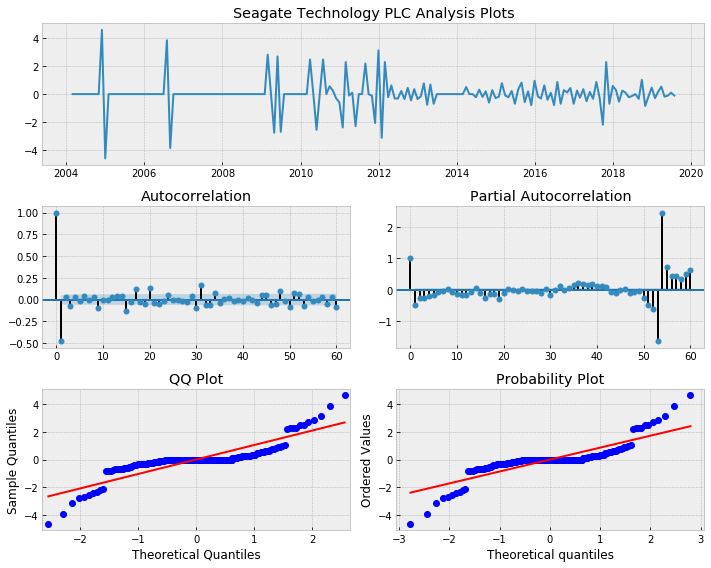

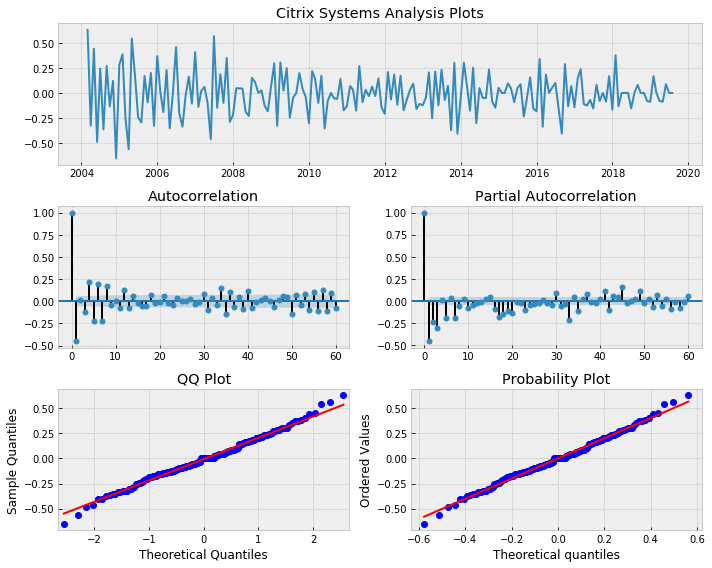

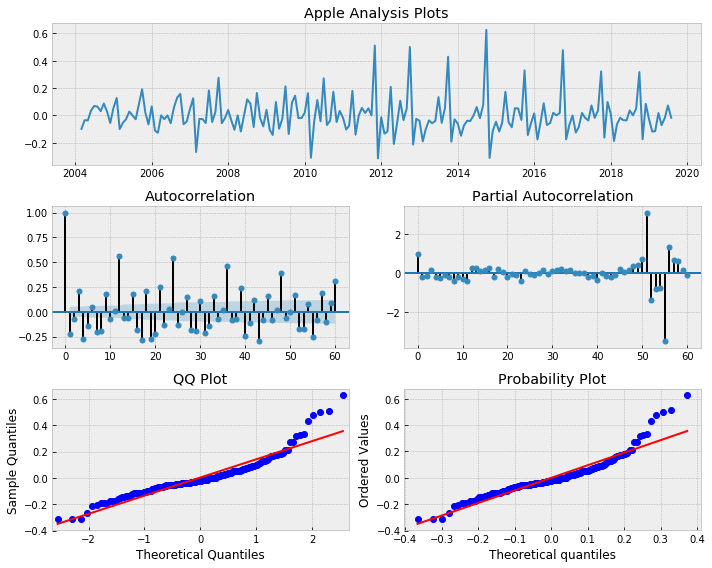

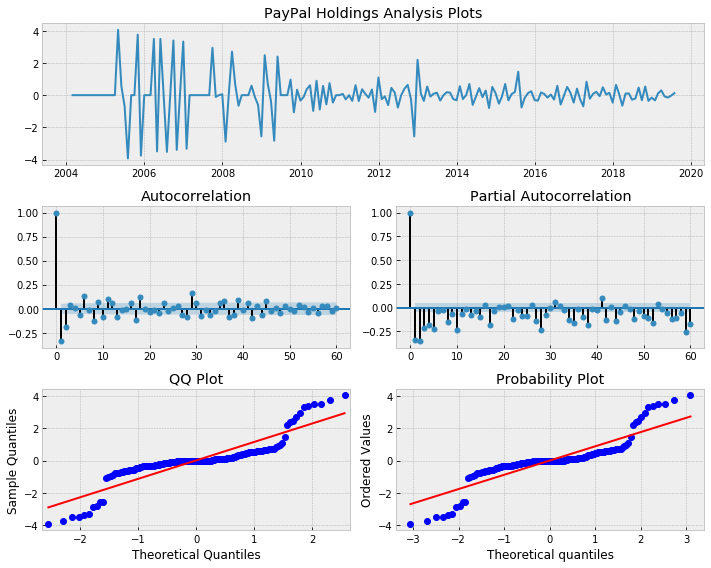

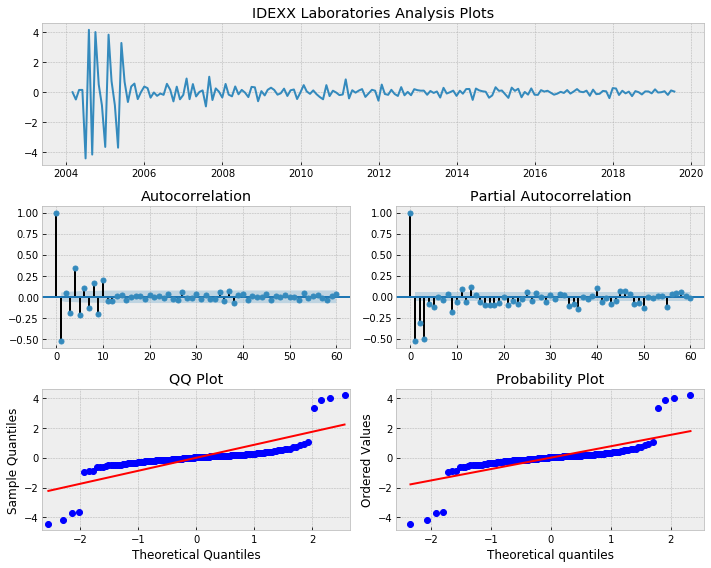

...

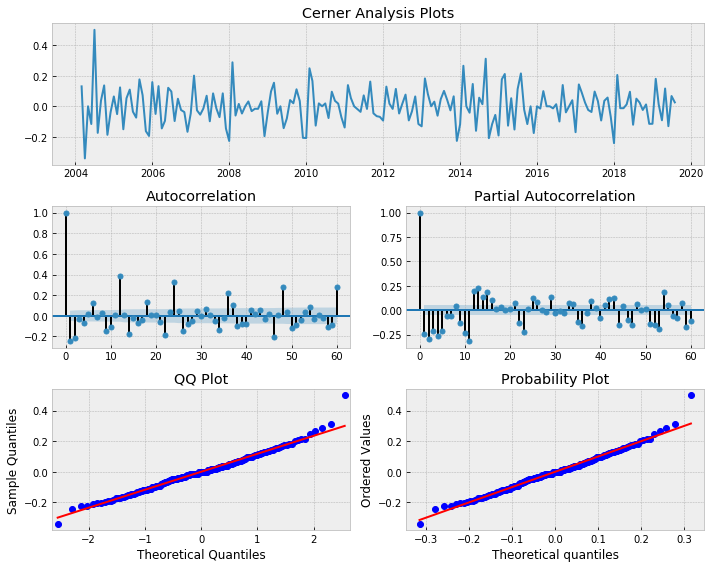

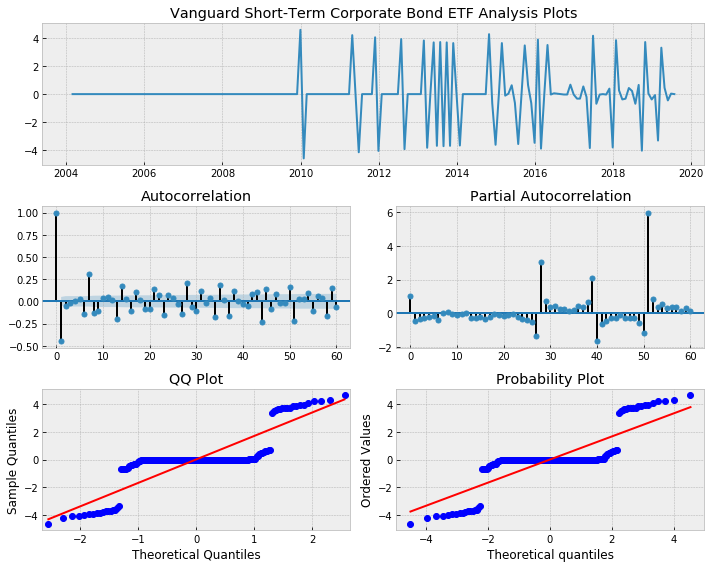

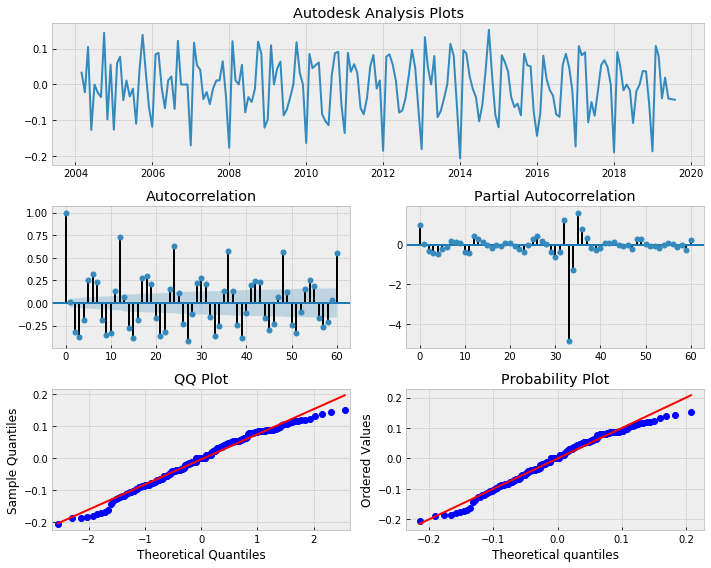

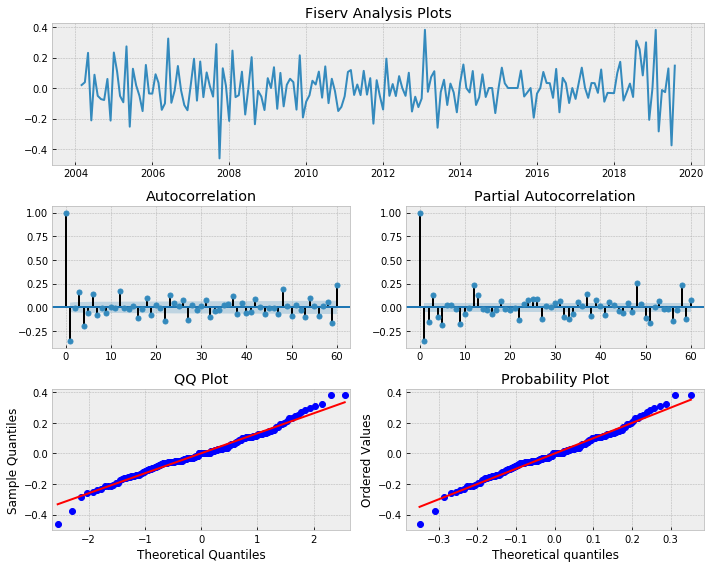

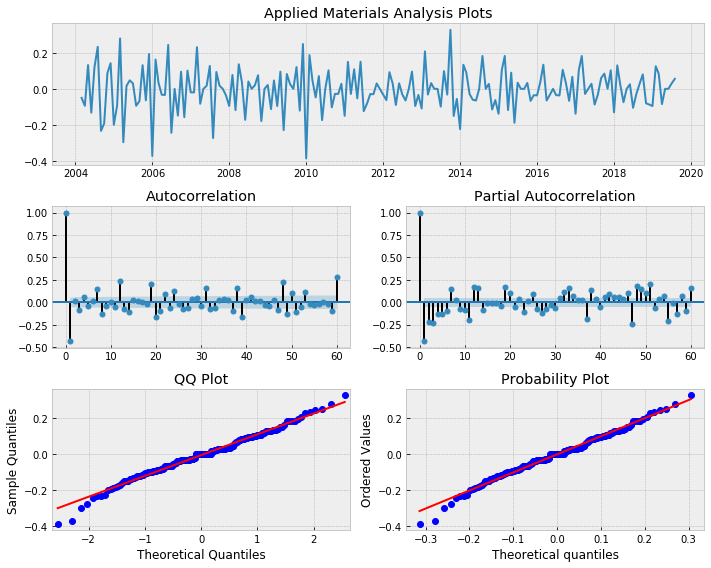

In [12]:
info_df_T = info_df_diff.pivot(columns = 'Ticker', index = 'Date', values = 'SVI')

values = list(set(series.values()) - set(['s&p500']))
for i in values:
    tsplot(y = info_df_T[i], title = i, time_id = info_df_T.reset_index()['Date'], lags = 60)
    plt.show()

In [13]:
info_df_diff.to_csv('./data/month_not_adjusted_information_df_diff.csv')

# Stock information

First of all, we download the data. We will use the close prices for each stock, retreived from $\textbf{Yahoo Finance}$. The data frequency is of 5 days a week (only working days). The result is that we have aproximately 21 data points per month. 

In [6]:
# Fix dates to retreive
df = pd.read_csv('./data/month_not_adjusted_information_df_diff.csv',infer_datetime_format=True, parse_dates=['Date'])

start_date = df.Date.min()
end_date = df.Date.max()

def get_stock(ticker):
    
    time.sleep(0.5)
    
    while True:
        try:
            r = pdr.get_data_yahoo(ticker, start=start_date, end=end_date)
            print(ticker)
            return r
            break

        except KeyError:
            print('no info found for', ticker)
            break
        except:
            print('Retry')
            pass
        
data = list(map(get_stock, series.keys()))

stock_df = pd.concat(data, keys=list(series.keys()), names=['Ticker', 'Date'])
stock_df = stock_df['Close']
stock_df = stock_df.unstack('Ticker')
# Save data
stock_df.to_csv('./data/stock.csv')

AAPL
GOOGL
MSFT
FB
AMZN
CMCSA
CSCO
INTC
AMGN
KHC
CHTR
CELG
WBA
GILD
AVGO
BKNG
QCOM
SBUX
TXN
COST
MDLZ
NVDA
ADBE
NFLX
BIIB
TMUS
PYPL
ADP
BIDU
AMOV
QQQ
CSX
TSLA
AMAT
CME
REGN
ATVI
EBAY
MAR
CTSH
NXPI
LBTYB
MU
INTU
EQIX
ADI
DISH
JD
INCY
ISRG
EA
ALXN
MNST
ROST
ILMN
ORLY
FISV
SIRI
PCAR
WDC
VRTX
PAYX
MYL
NTES
HBANO
AAL
LRCX
CTRP
AMTD
NTRS
EXPE
ADSK
CERN
SYMC
FITB
CHKP
SWKS
VCSH
DLTR
VIA
WLTW
ULTA
INFO
TROW
MCHP
LBRDK
BMRN
KLAC
FAST
XLNX
XRAY
SBAC
IBKR
HSIC
IDXX
STX
VRSK
CTAS
CTXS
SPY


It is well known that prices are I(1).

In [7]:
prices = pd.read_csv('./data/stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
list(prices.Date.unique()[-10:])

[numpy.datetime64('2019-07-18T00:00:00.000000000'),
 numpy.datetime64('2019-07-19T00:00:00.000000000'),
 numpy.datetime64('2019-07-22T00:00:00.000000000'),
 numpy.datetime64('2019-07-23T00:00:00.000000000'),
 numpy.datetime64('2019-07-24T00:00:00.000000000'),
 numpy.datetime64('2019-07-25T00:00:00.000000000'),
 numpy.datetime64('2019-07-26T00:00:00.000000000'),
 numpy.datetime64('2019-07-29T00:00:00.000000000'),
 numpy.datetime64('2019-07-30T00:00:00.000000000'),
 numpy.datetime64('2019-07-31T00:00:00.000000000')]

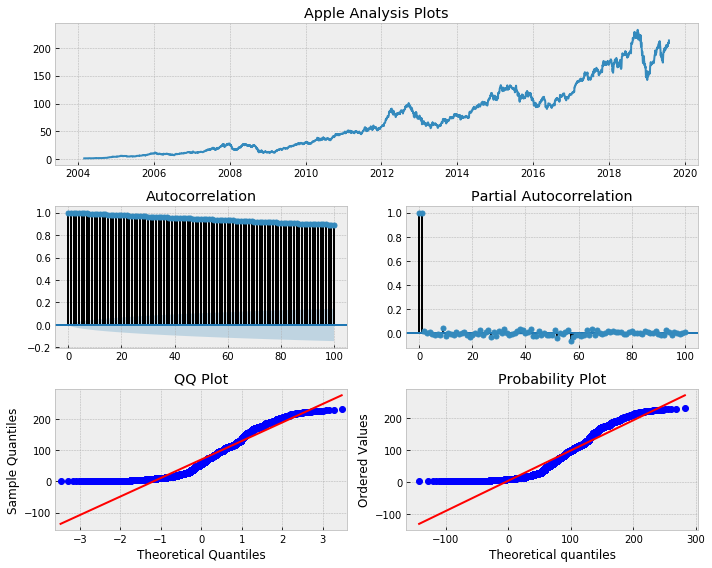

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


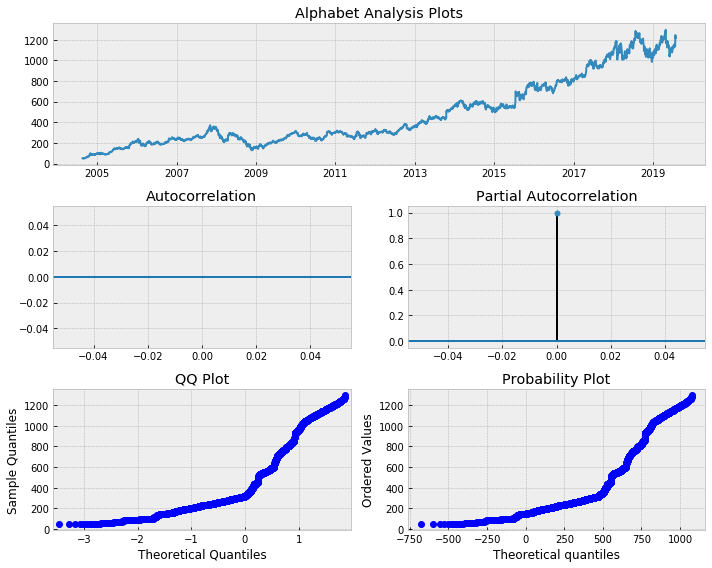

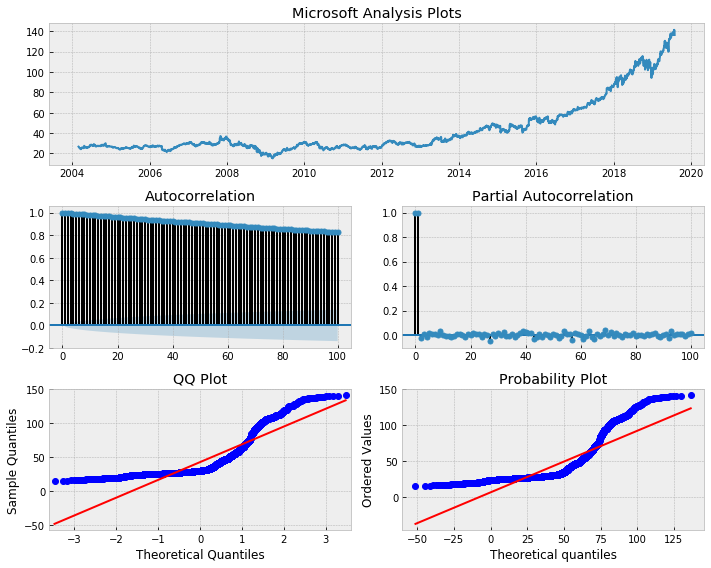

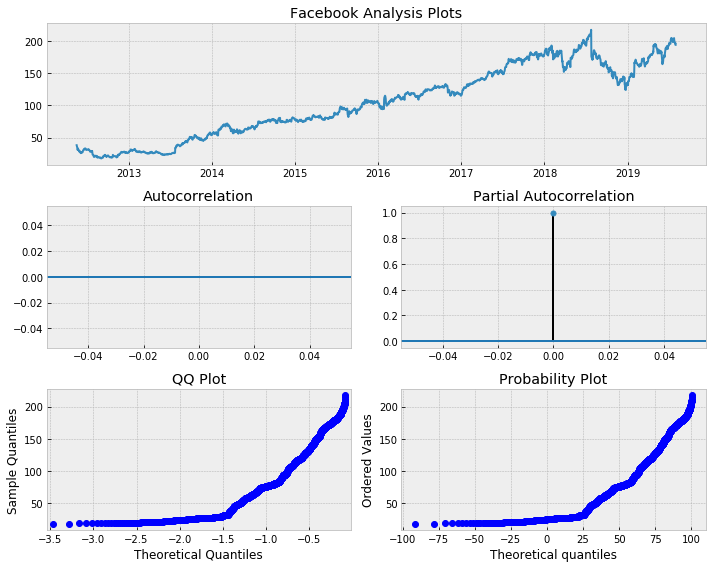

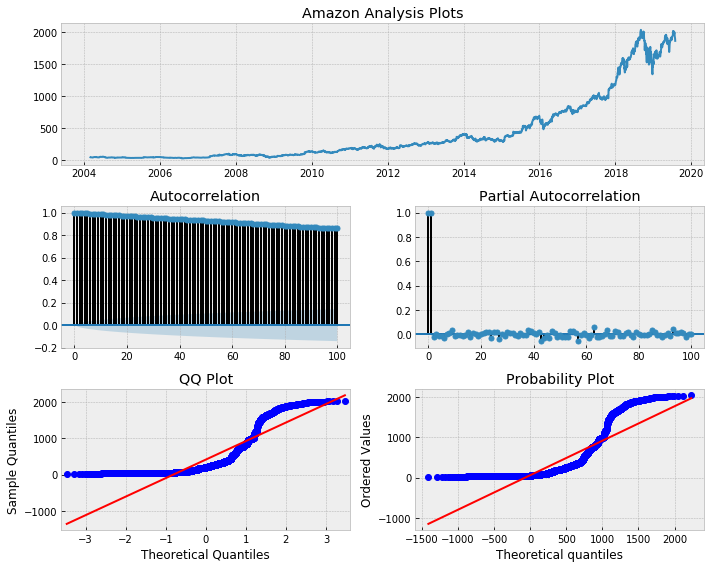

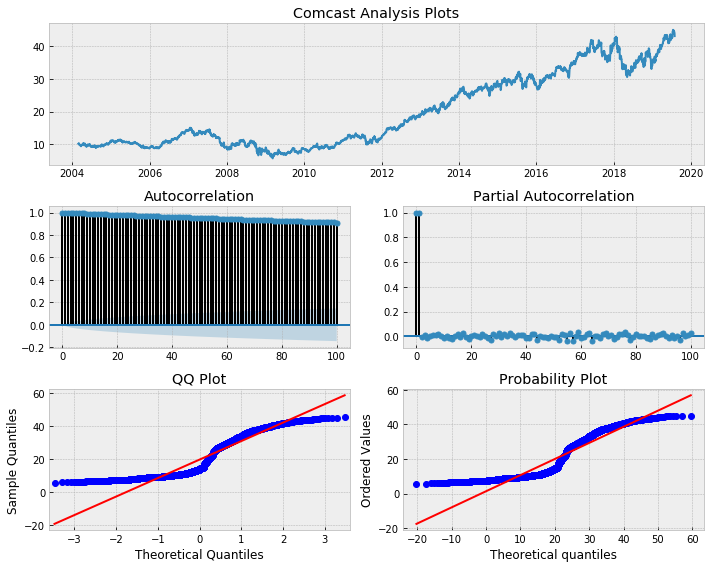

...

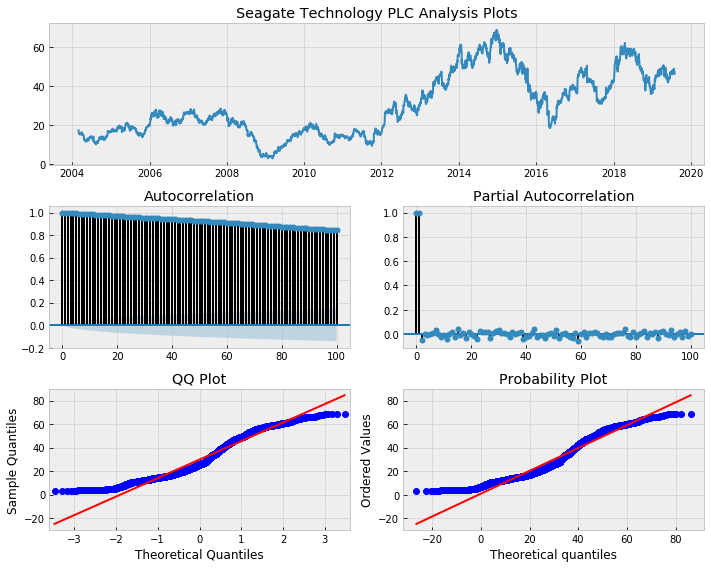

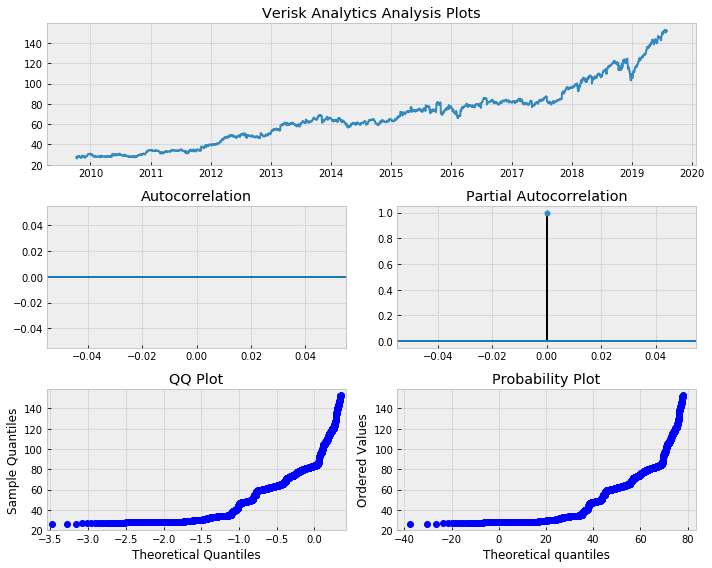

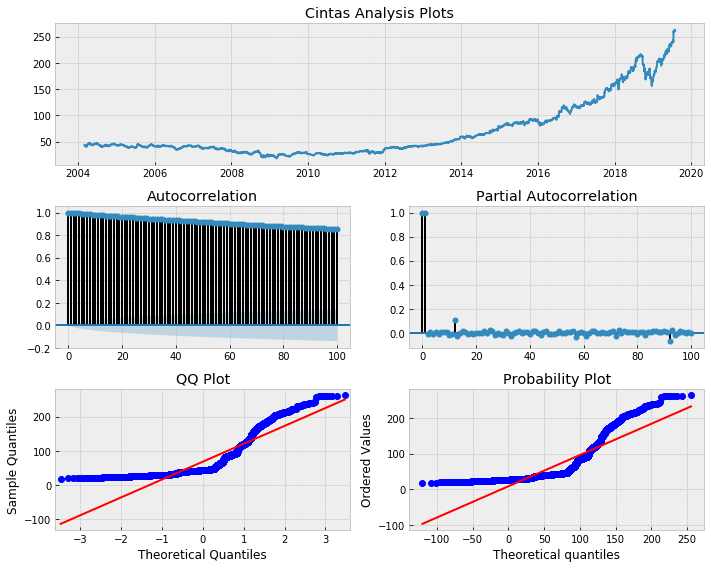

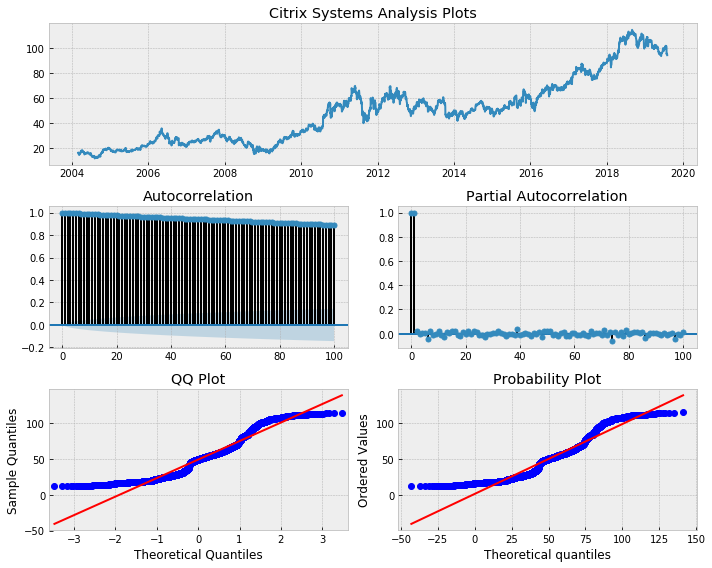

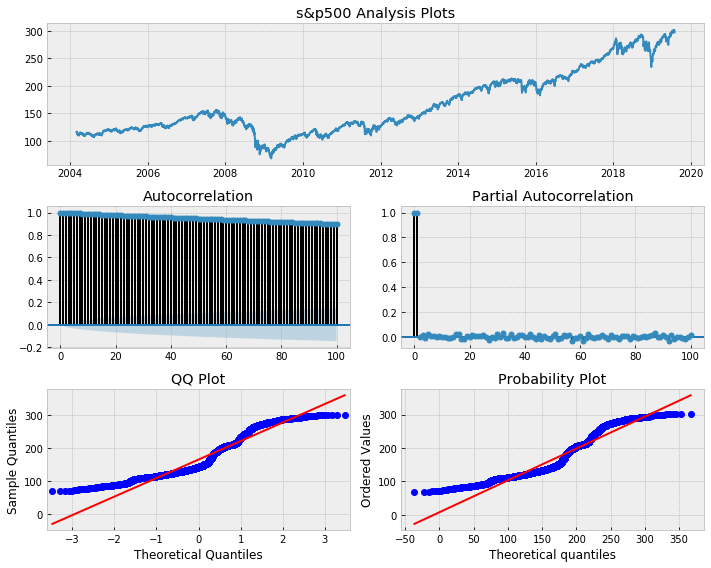

In [16]:
prices = pd.read_csv('./data/stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
# prices = prices.drop(columns = 'SPY')

for i in series.keys():
    tsplot(y = prices[i], title = series[i], time_id = prices['Date'], lags = 100)
    plt.show()

## Realized Volatility

Realized volatility is one of the most popular measures of historical
volatility in the literature at present due to its accuracy
and model-free nature (Andersen et al., 2001a,b https://www.sciencedirect.com/science/article/pii/S0304405X01000551 https://www.tandfonline.com/doi/abs/10.1198/016214501750332965; Barndorff-Nielsen
and Shephard, 2002https://rss.onlinelibrary.wiley.com/doi/full/10.1111/1467-9868.00336 ; inter alia). 

In the calculation of realized volatilities
for our series we follow the methodology of Andersen et al.
(2001a). In particular, we calculate logarithmic returns for all our dataset. In particular, we calculate daily logarithmic returns
from our stock price data. The returns are filtered
by taking the residuals from a $MA(1)$ model in order to remove
the typically found negative serial correlation. Consistent
with the findings in Andersen et al. (2001a), all estimated moving
average coefficients are negative or not significant in our data. We then calculate
weekly realized volatilities, by summing squared returns for each
month. The realized volatility for month t is given by
\begin{align}
r_{t,i} = p_{t,i} - p_{t-1,i} \\
RV_t = \log\left[\sum^N_{i=1}r^2_{t,i}\right]
\end{align}

In [8]:
# Read data 
STK_df = pd.read_csv('./data/stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])

# Returns
# STK_df[list(series.keys())] = STK_df.sort_values(by = 'Date')[list(series.keys())].ffill()
STK_df[list(series.keys())] = STK_df[list(series.keys())].diff(1)
# STK_df.dropna(inplace=True)
print(STK_df.Date.min())

# Stack dataframe
STK_df = STK_df.set_index('Date').stack().reset_index()
STK_df.columns = ['Date','Ticker','Price']
STK_df = STK_df.set_index('Date')

# Filter by taking residuals of MA(1)
RV_df = pd.DataFrame()
parameters = pd.DataFrame()

for t, df in STK_df.groupby('Ticker'):
    
    model = am.ARIMA(df.drop(columns = 'Ticker'),
                     order = (0,0,1))
    result = model.fit(trend = 'c')
    # Keep residuals
    df['RV'] = result.resid
    RV_df = pd.concat([RV_df, df], axis=0)
    # Get model coeficients
    df_aux = pd.DataFrame([[t, result.params[1], result.pvalues[1]]], columns = ['Ticker','Coef','Pvalue'])
    parameters = pd.concat([parameters, df_aux])
    
RV_df = RV_df.reset_index()
RV_df = RV_df.drop(columns = 'Price')

# Calculate the 1st day of next month
def next_1_day_month(x):
    x = x.to_pydatetime()
    if x.month != 12:
        nextmonthdate = x.replace(day = 1).replace(month=x.month+1)
    else:
        nextmonthdate = x.replace(day = 1).replace(year=x.year+1, month=1)
        
    nextmonthdate = nextmonthdate - datetime.timedelta(days=1)

    return nextmonthdate

def next_sunday(x):
    x = x.to_pydatetime()
    idx = 7- (x.weekday() + 1)%7    
    
    return x + datetime.timedelta(idx)

RV_df['Date'] = RV_df.Date.map(next_1_day_month)

# Filter dates without data
d1 = date(2008,3,31)
d2 = date(2019,6,30)
# RV_df = RV_df.query('Date > @d1 & Date < @d2')
RV_df = RV_df.set_index('Date')

# Calculate implied volatility for each period
# RV_df = RV_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x**2)/x.shape[0]).reset_index()
RV_df = RV_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x**2)).reset_index()
RV_df['RV'] = np.log(RV_df['RV'])
RV_df

2004-03-01 00:00:00


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaco

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated 

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueW

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  ' ignored when e.g. forecasting.', ValueWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:225: ValueW

,Date,Ticker,RV
0,2004-03-31,AAPL,-2.257182
1,2004-03-31,ADBE,1.648228
2,2004-03-31,ADI,3.135098
3,2004-03-31,ADP,1.542011
4,2004-03-31,ADSK,0.236610
5,2004-03-31,ALXN,0.182166
6,2004-03-31,AMAT,1.285406
7,2004-03-31,AMGN,3.179526
8,2004-03-31,AMOV,-0.383849
9,2004-03-31,AMTD,1.503873


In [9]:
parameters

,Ticker,Coef,Pvalue
0,AAL,0.041212,1.392901e-02
0,AAPL,0.013280,4.246130e-01
0,ADBE,-0.098671,8.694188e-09
0,ADI,-0.048125,4.265496e-03
0,ADP,-0.043912,7.681032e-03
0,ADSK,-0.020394,2.013377e-01
0,ALXN,-0.030014,6.478154e-02
0,AMAT,-0.037894,2.042464e-02
0,AMGN,-0.021827,1.850926e-01
0,AMOV,-0.110117,6.644288e-11


42.00% of companies with a negative and significant effect


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
No handles with labels found to put in legend.


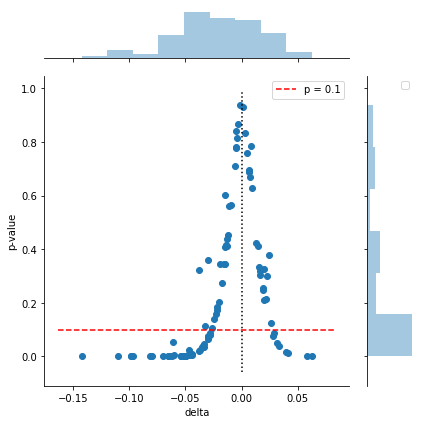

In [10]:
#########################################
# Plot final effects
#########################################
# Get points
x = parameters.Coef
y = parameters.Pvalue
# Coverage
per = np.sum((x<0)&(y<0.1))
print('{0:.2f}% of companies with a negative and significant effect'.format(per))
# plot
h = sns.jointplot(x,y)
# plot extra lines
x0, x1 = h.ax_joint.get_xlim()
y0, y1 = h.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
h.ax_joint.plot([0,0], [y0,y1], ':k')  
phantom, = h.ax_joint.plot([x0, x1], [0.1,0.1], '--r', label = 'p = 0.1')  

# legend 
h.ax_joint.legend([phantom],['p = 0.1'])

h.ax_joint.set_xlabel('delta')
h.ax_joint.set_ylabel('p-value')
plt.tight_layout()
plt.legend()
plt.show()

Check for stationarity

In [11]:
''' DF test:
    H0: there is a unit root
    H1: no unit root
'''

def df_test_nc(x):
    return ts.adfuller(x, regression = 'nc')[1]

def df_test_ct(x):
    return ts.adfuller(x, regression = 'ct')[1]

def df_test_c(x):
    return ts.adfuller(x, regression = 'c')[1]

def Kwiatkowski_Phillips_Schmidt_Shin(x):
    return ts.kpss(x, regression = 'ct')[1]

DF_df = RV_df.drop(columns = 'Date').groupby('Ticker').aggregate([df_test_ct, df_test_c, df_test_nc, Kwiatkowski_Phillips_Schmidt_Shin])
DF_df.round(decimals = 2)

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1276: InterpolationWarning: p-value is smaller than the indicated p-value
  warn("p-value is smaller than the indicated p-value", InterpolationWarning)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tsa\stattools.py:1278: InterpolationWarning: p-value is greater than the indicated p-value
  warn("p-value is greater than the indicated p-value", InterpolationWarning)
C:\Users

RV                                                       
       df_test_ct df_test_c df_test_nc Kwiatkowski_Phillips_Schmidt_Shin
Ticker                                                                  
AAL          0.65      0.36       0.34                              0.01
AAPL         0.01      0.26       0.71                              0.03
ADBE         0.52      0.95       0.96                              0.01
ADI          0.04      0.63       0.75                              0.01
ADP          0.03      0.52       0.80                              0.02
ADSK         0.88      0.87       0.95                              0.01
ALXN         0.94      0.44       0.79                              0.01
AMAT         0.61      0.69       0.48                              0.01
AMGN         0.01      0.75       0.84                              0.03
AMOV         0.17      0.09       0.23                              0.02
AMTD         0.01      0.03       0.17                              0.02
AMZN         0.02      0.95       0.98                              0.10
ATVI         0.13      0.34       0.14                              0.01
AVGO         0.10      0.73       0.95                              0.10
BIDU         0.63      0.41       0.62                              0.01
BIIB         0.09      0.34       0.61                              0.10
BKNG         0.65      0.49       0.93                              0.01
BMRN         0.41      0.46       0.66                              0.10
CELG         0.21      0.16       0.44                              0.10
CERN         0.02      0.30       0.52                              0.01
CHKP         0.02      0.58       0.66                              0.10
CHTR         0.00      0.28       0.82                              0.02
CMCSA        0.01      0.24       0.04                              0.10
CME          0.10      0.03       0.70                              0.05
COST         0.06      0.68       0.88                              0.10
CSCO         0.32      0.15       0.25                              0.08
CSX          0.08      0.24       0.26                              0.05
CTAS         0.95      0.99       0.97                              0.01
CTRP         0.05      0.21       0.27                              0.03
CTSH         0.01      0.06       0.39                              0.06
...           ...       ...        ...                               ...
NXPI         0.35      0.13       0.63                              0.10
ORLY         0.00      0.86       0.95                              0.04
PAYX         0.89      0.71       0.77                              0.01
PCAR         0.16      0.04       0.55                              0.08
PYPL         0.02      0.74       0.74                              0.10
QCOM         0.00      0.00       0.62                              0.10
QQQ          0.02      0.40       0.81                              0.10
REGN         0.77      0.76       0.87                              0.05
ROST         0.01      0.91       0.77                              0.10
SBAC         0.02      0.19       0.78                              0.10
SBUX         0.00      0.77       0.78                              0.10
SIRI         0.14      0.04       0.39                              0.01
SPY          0.02      0.02       0.70                              0.10
STX          0.25      0.41       0.73                              0.10
SWKS         0.03      0.76       0.65                              0.10
SYMC         0.00      0.00       0.19                              0.02
TMUS         0.12      0.02       0.24                              0.01
TROW         0.53      0.22       0.70                              0.04
TSLA         0.71      0.42       0.82                              0.05
TXN          0.94      0.98       0.95                              0.01
ULTA         0.11      0.88       0.96                              0.10


Realised Volatility is I(0)

At last, we calculate market and firm log-returns to control for it in the model. 

In [12]:
# Read data 
series_ret_df = pd.read_csv('./data/stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
series_ret_df = series_ret_df.drop(columns = 'SPY')
series_ret_df = series_ret_df.set_index('Date').stack().reset_index()
series_ret_df.columns = ['Date', 'Ticker', 'ret']

# Returns
series_ret_df['ret'] = series_ret_df.groupby('Ticker')['ret'].apply(lambda x: np.log(x))
series_ret_df['ret'] = series_ret_df.groupby('Ticker')['ret'].diff(1)

# Aggregate periods
series_ret_df['Date'] = series_ret_df.Date.map(next_1_day_month)
series_ret_df = series_ret_df.groupby(['Date','Ticker']).agg(lambda x: np.sum(x)).reset_index()

series_ret_df['ret_1'] = series_ret_df.groupby('Ticker')['ret'].shift(1)

# Read data 
market_ret_df = pd.read_csv('./data/stock.csv', 
                     infer_datetime_format=True, parse_dates=['Date'])
# Only market data
market_ret_df = market_ret_df[['Date','SPY']]
# Logarithmic returns
market_ret_df['SPY'] = np.log(market_ret_df['SPY'])
market_ret_df['SPY'] = market_ret_df['SPY'].diff(1)

# Aggregate periods
market_ret_df['Date'] = market_ret_df.Date.map(next_1_day_month)
market_ret_df = market_ret_df.groupby(['Date']).agg(lambda x: np.sum(x)).reset_index()

market_ret_df['SPY_1'] = market_ret_df['SPY'].shift(1)
# Drop nan
market_ret_df = market_ret_df.dropna()
market_ret_df.head()

,Date,SPY,SPY_1
1,2004-04-30,-0.019103,-0.026696
2,2004-05-31,0.016978,-0.019103
3,2004-06-30,0.014689,0.016978
4,2004-07-31,-0.032749,0.014689
5,2004-08-31,0.002433,-0.032749


We use the following regression in order to study the relationship
between realized volatility and information demand while
controlling for the effect of market returns:
\begin{equation}
RV_t = \omega + \gamma\pi_t + \delta\phi_t +  \lambda\nu_t + \theta\nu_{t-1} + \psi RV_{t-1} + \epsilon_t
\end{equation}

where $\omega$ is the constant, $\pi_t$ is idiosyncratic information demand at
time $t$, $\phi_t$ is market-related information demand at time t, $\nu_t$ is the market return at time t and $\epsilon_t$ are the
errors.

In [23]:
info_df = pd.read_csv('./data/month_not_adjusted_information_df_diff.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')

inv_series = dict([(i[1],i[0]) for i in series.items()])
info_df['Ticker'] = info_df['Ticker'].map(inv_series)

# Save market's realized volatility 
s = 'SPY'
rv_df = RV_df.query('Ticker != @s')
m_rv_df = RV_df.query('Ticker == @s').drop(columns = ['Ticker']).rename(columns = {'RV':'market_RV'})
returns_df = pd.merge(rv_df, m_rv_df, on='Date')

# Save ideosincratic return
info_df = pd.merge(info_df, series_ret_df)

# Merge dataframes
df = pd.merge(returns_df, info_df)
df = pd.merge(df,market_ret_df)

# # Create Variables
df['RV_1'] = df.groupby('Ticker')['RV'].shift(1)
df['market_RV_1'] = df.groupby('Ticker')['market_RV'].shift(1)

df = df.dropna()

# Map industries
df['sector'] =  df['Ticker'].map(sectors_dict)
df['sector'] =  df['sector'].fillna('Miscellaneous')
df = df[(df.Date.dt.year > 2007) & (df.Date.dt.year < 2019)]

# Save 
df.to_csv('./data/regresion.csv')

In [70]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date'])


pvalues = pd.DataFrame()
parameters = pd.DataFrame()
residuals = pd.DataFrame()
r_squared_adj = dict()
aic_all = dict()

for t, data in df.groupby('Ticker'):
    
    var = ['SVI','market_info','SPY','SPY_1','RV_1']
#     var = ['SVI','market_info','SPY','RV_1']
    
    y = data['RV']
    X = sm.add_constant(data[var])
    model = sm.GLS(y, X)
    result = model.fit()
#     result = result.get_robustcov_results(cov_type = 'HAC', maxlags = int(data.shape[0]**(1/4)))
    # Get model coeficients
    
    df_coef = pd.DataFrame([[t] + list(result.params)], columns = ['Ticker'] + ['const'] + var)
    parameters = pd.concat([parameters, df_coef])
    
    df_aux = pd.DataFrame([[t] + list(result.pvalues)], columns = ['Ticker'] + ['const'] + var)
    pvalues = pd.concat([pvalues, df_aux])
    
    # Get residuals
    df_resid = pd.DataFrame({'resid':result.resid, 
                             'Date': data['Date']})
    df_resid['Ticker'] = t
    residuals = pd.concat([residuals, df_resid])
    
    # Get r^2
    r_squared_adj[t] = result.rsquared
    aic_all[t] = result.aic
    

print(parameters.sort_values(by = ['SVI']))
pvalues.sort_values(by = ['SVI'])

   Ticker     const       SVI  market_info        SPY     SPY_1      RV_1
0    CTAS  0.492618 -3.894836     1.375128  -1.764290  1.447474  0.792528
0    EBAY  0.329610 -2.291158     1.581583  -1.337746  0.536097  0.524458
0      FB  1.387014 -1.809203     1.383731  -4.838534 -2.568523  0.640511
0   GOOGL  2.344522 -1.406081     1.774359  -2.314152  0.106696  0.654173
0    AMZN  0.970060 -1.392158     1.408642  -1.835062  1.737808  0.857734
0    DISH  0.959604 -1.296642     0.573739  -3.482159  1.427586  0.581647
0    EXPE  2.728605 -1.058454     1.014458   1.262683 -1.666511  0.268178
0     WDC  1.291545 -0.692880     0.672005  -1.949004  0.835556  0.601934
0     TXN  0.703725 -0.489300     1.198045  -2.408627 -1.432832  0.670412
0    IBKR  0.231138 -0.345335     1.412522  -1.044427 -0.216067  0.819862
0    CTSH  0.857854 -0.315803     1.511860  -1.467378  1.053009  0.601500
0   CMCSA  0.090061 -0.285101     1.185846  -1.471790  0.399706  0.770730
0    COST  0.869587 -0.276269     1.44

,Ticker,const,SVI,market_info,SPY,SPY_1,RV_1
0,BIIB,5.337846e-03,1.636093e-09,2.938528e-02,0.995003,0.979879,4.439507e-43
0,ATVI,4.342752e-02,1.702828e-09,7.704639e-03,0.291145,0.192124,4.996127e-37
0,VRTX,1.806712e-04,1.206064e-08,1.821405e-03,0.015203,0.445039,9.954722e-28
0,CELG,9.188417e-04,1.586083e-08,5.758099e-04,0.818555,0.834323,9.802144e-37
0,SWKS,2.572446e-03,1.275845e-07,7.365573e-05,0.335492,0.299295,1.129802e-43
0,ISRG,5.339632e-08,5.080162e-07,1.084518e-01,0.093039,0.102055,2.202542e-13
0,MDLZ,1.013463e-09,6.670585e-07,4.668716e-02,0.000194,0.270569,3.496341e-06
0,MU,6.028004e-02,6.045396e-06,9.989493e-02,0.034863,0.005709,9.641221e-47
0,MNST,7.199669e-02,2.067020e-05,4.642329e-03,0.308505,0.508707,1.080947e-36
0,INFO,2.988663e-05,3.464867e-05,2.379059e-02,0.039272,0.749501,2.067352e-03


28.00% of companies with a positive and significant effect


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
No handles with labels found to put in legend.


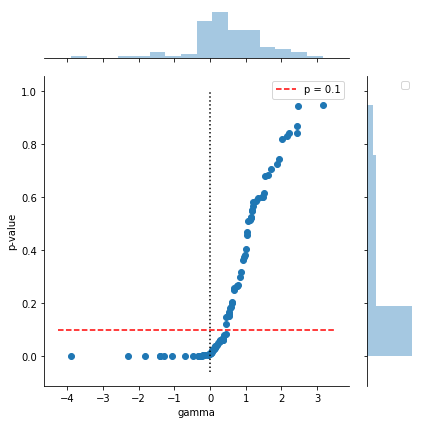

88.00% of companies with a negative and significant effect


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
No handles with labels found to put in legend.


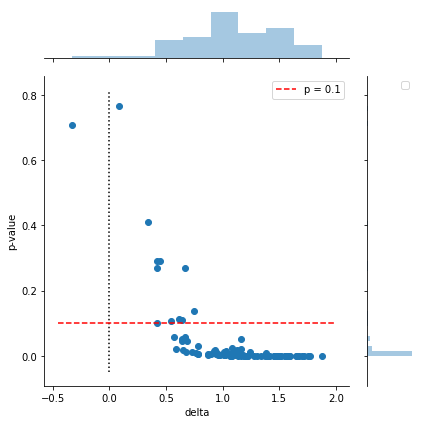

In [38]:
#########################################
# Plot company effects
#########################################
# Get points
x = parameters[parameters.SVI > -10].sort_values(by = ['SVI']).SVI
y = pvalues[parameters.SVI > -10].sort_values(by = ['SVI']).SVI
# Coverage
per = np.sum((x>0)&(y<0.1))
print('{0:.2f}% of companies with a positive and significant effect'.format(per))
# plot
h = sns.jointplot(x,y)
# plot extra lines
x0, x1 = h.ax_joint.get_xlim()
y0, y1 = h.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
h.ax_joint.plot([0,0], [y0,y1], ':k')  
phantom, = h.ax_joint.plot([x0, x1], [0.1,0.1], '--r', label = 'p = 0.1')  

# legend 
h.ax_joint.legend([phantom],['p = 0.1'])


h.ax_joint.set_xlabel('gamma')
h.ax_joint.set_ylabel('p-value')
plt.tight_layout()
plt.legend()
plt.show()

#########################################
# Plot market effects
#########################################
# Get points
x = parameters.market_info
y = pvalues.market_info
# Coverage
per = np.sum((x>0)&(y<0.1))
print('{0:.2f}% of companies with a negative and significant effect'.format(per))
# plot
h = sns.jointplot(x,y)
# plot extra lines
x0, x1 = h.ax_joint.get_xlim()
y0, y1 = h.ax_joint.get_ylim()
lims = [max(x0, y0), min(x1, y1)]
h.ax_joint.plot([0,0], [y0,y1], ':k')  
phantom, = h.ax_joint.plot([x0, x1], [0.1,0.1], '--r', label = 'p = 0.1')  

# legend 
h.ax_joint.legend([phantom],['p = 0.1'])


h.ax_joint.set_xlabel('delta')
h.ax_joint.set_ylabel('p-value')
plt.tight_layout()
plt.legend()
plt.show()

In [39]:
cols = list(parameters.columns)
cols.remove('Ticker')
df_all = pd.merge(parameters, pvalues, on='Ticker').set_index('Ticker')

def preparar_tabla(x):
    for c in cols:
        if x[c+'_y'] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{***}$"
        elif x[c+'_y'] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{**}$"
        elif x[c+'_y'] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c+'_x']))
            
    return(x)

df_all = df_all.apply(preparar_tabla, axis = 1)[cols].reset_index().round(decimals = 2)
df_all['R_sqr'] = df_all['Ticker'].map(r_squared_adj).round(decimals = 2)
df_all['AIC'] = df_all['Ticker'].map(aic_all).round(decimals = 2)
df_all

,Ticker,const,SVI,market_info,SPY,SPY_1,RV_1,R_sqr,AIC
0,AAL,0.277$^{***}$,0.183,0.785$^{***}$,-0.475,0.762,0.84$^{***}$,0.72,268.55
1,AAPL,0.603$^{***}$,0.959$^{**}$,1.72$^{***}$,-0.69,3.71$^{**}$,0.808$^{***}$,0.70,294.97
2,ADBE,0.578$^{***}$,-0.273,1.55$^{***}$,-2.86$^{*}$,0.808,0.812$^{***}$,0.68,323.83
3,ADI,0.793$^{***}$,1.88$^{***}$,0.761$^{***}$,-2.01,0.903,0.677$^{***}$,0.50,255.16
4,ADP,0.529$^{***}$,0.352,1.75$^{***}$,-1.95,-0.642,0.77$^{***}$,0.67,256.33
5,ADSK,0.904$^{***}$,0.151,1.18$^{***}$,-1.63,0.645,0.698$^{***}$,0.50,325.17
6,ALXN,0.426$^{***}$,0.758$^{***}$,0.682$^{**}$,-3.88$^{**}$,0.937,0.899$^{***}$,0.83,303.04
7,AMAT,0.171$^{**}$,1.19$^{**}$,0.649$^{**}$,-3.41$^{***}$,0.269,0.845$^{***}$,0.74,255.48
8,AMGN,0.891$^{***}$,-0.0353,1.57$^{***}$,-4.05$^{***}$,0.864,0.76$^{***}$,0.65,293.76
9,AMOV,0.471$^{***}$,0.0234,0.867$^{***}$,-1.76,-0.359,0.568$^{***}$,0.37,273.71


In [26]:
df_1 = df_all[['Ticker','R_sqr','AIC']]

In [27]:
df_all.to_csv('./data/bad_ARDL_parameters.csv')

Finally, basing ourselves on AIC, and significance of variables we estimate the model (idiosyncratic information demand is not relevant). 

\begin{equation}
RV_t = \omega + \delta\phi_t +  \lambda\nu_t + \psi RV_{t-1} + \epsilon_t
\end{equation}

where $\omega$ is the constant, $\phi_t$ is market-related information demand at time t, $\nu_t$ is the market return at time t and $\epsilon_t$ are the
errors.

In [28]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date'])

pvalues = pd.DataFrame()
parameters = pd.DataFrame()
residuals = pd.DataFrame()
models = dict()
r_squared_adj = dict()
aic_all = dict()

for t, data in df.groupby('Ticker'):
    
    var = ['market_info','SPY','RV_1']
    
    y = data['RV']
    X = sm.add_constant(data[var])
    model = sm.GLS(y, X)
    result = model.fit()
#     result = result.get_robustcov_results(cov_type = 'HAC', maxlags = int(data.shape[0]**(1/4)))
    # Get model coeficients
    
    df_coef = pd.DataFrame([[t] + list(result.params)], columns = ['Ticker'] + ['const'] + var)
    parameters = pd.concat([parameters, df_coef])
    
    df_aux = pd.DataFrame([[t] + list(result.pvalues)], columns = ['Ticker'] + ['const'] + var)
    pvalues = pd.concat([pvalues, df_aux])
    
    # Get residuals
    df_resid = pd.DataFrame({'resid':result.resid, 
                             'Date': data['Date']})
    df_resid['Ticker'] = t
    residuals = pd.concat([residuals, df_resid])
    
    # Get models
    models[t] = result
    
    r_squared_adj[t] = result.rsquared_adj
    aic_all[t] = result.aic
    
    

print(parameters.sort_values(by = ['market_info']))
pvalues.sort_values(by = ['market_info'])

   Ticker     const  market_info        SPY      RV_1
0   LBTYB  1.383753    -0.264735 -14.732373 -0.082676
0    VCSH -1.104369     0.071038  -1.856675  0.419852
0    ULTA  0.622007     0.200859  -2.114551  0.851841
0      JD  1.050107     0.370113  -0.420542  0.545482
0    DLTR  0.512353     0.446100  -2.417467  0.778275
0      MU  0.173171     0.507005  -2.111801  0.874258
0    SYMC  0.738812     0.538014  -3.380309  0.139686
0    KLAC  1.363010     0.551883  -1.740441  0.543255
0     KHC  2.783370     0.598477   0.201850 -0.011002
0    QCOM  2.131416     0.600657  -4.719567  0.227299
0    PYPL  0.654098     0.605692  -4.849658  0.772013
0    DISH  1.008130     0.651681  -3.128765  0.567690
0     STX  0.905019     0.668310   0.762046  0.596803
0     WDC  1.338761     0.681360  -1.993082  0.592086
0    AMAT  0.169801     0.721438  -2.917531  0.839093
0   LBRDK  1.727543     0.764793  -4.035214  0.419236
0    MDLZ  0.809818     0.769853  -5.405482  0.355729
0    PCAR  1.415588     0.78

,Ticker,const,market_info,SPY,RV_1
0,QQQ,6.663002e-07,2.389908e-10,0.000013,3.944529e-25
0,SBAC,7.323732e-04,5.751365e-10,0.022661,2.063897e-41
0,ADP,8.533184e-05,1.305104e-09,0.090464,1.630645e-28
0,AMTD,2.013537e-05,2.912129e-09,0.040535,1.873910e-25
0,MAR,2.213939e-04,3.725349e-09,0.348607,4.571281e-27
0,NTRS,5.638670e-05,8.062374e-08,0.046932,8.083063e-26
0,COST,2.764698e-05,1.433626e-07,0.034906,1.749768e-25
0,FISV,3.138078e-02,1.521967e-07,0.051456,8.590149e-34
0,PAYX,7.131231e-08,1.780225e-07,0.006445,2.387306e-13
0,EBAY,2.401056e-05,9.197132e-07,0.378075,2.339354e-11


We have to confirm that our especification is good, so that residuals are white noise. We can perform a Durbin-Watson and a Ljung-Box test for white noise.  

In [29]:
def Durbin_Watson(x):
    return(durbin_watson(x))

def Ljung_Box(x):
    return(np.mean(acorr_ljungbox(x, lags = int(5))[1]))

WN_df = residuals
WN_df = WN_df.drop(columns = 'Date').groupby('Ticker').aggregate([Durbin_Watson,Ljung_Box])
WN_df = WN_df['resid'].reset_index().sort_values(by = 'Ljung_Box')
# WN_df['breusch_godfrey'] = WN_df['Ticker'].map(lambda x: acorr_breusch_godfrey(models[x])[1]).round(decimals = 2)
WN_df

,Ticker,Durbin_Watson,Ljung_Box
83,SWKS,2.910222,6.841946e-08
71,ORLY,2.904685,4.034040e-07
67,NTES,2.821133,2.330098e-06
66,NFLX,2.746791,3.095622e-06
48,INCY,2.838993,3.197045e-06
41,GILD,2.837937,5.557504e-06
19,CERN,2.748078,7.344941e-06
60,MCHP,2.719164,1.486960e-05
13,AVGO,2.887020,1.768472e-05
62,MNST,2.744963,2.314476e-05


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:1283: RuntimeWarning: invalid value encountered in sqrt
  return rho, np.sqrt(sigmasq)


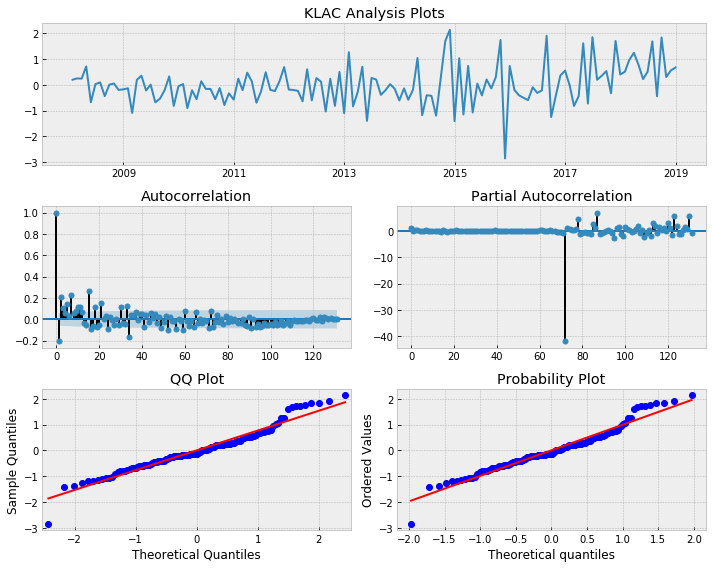

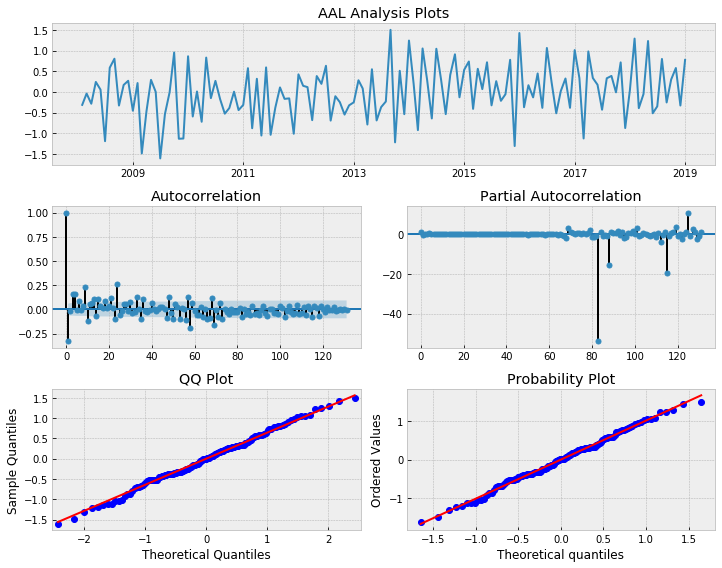

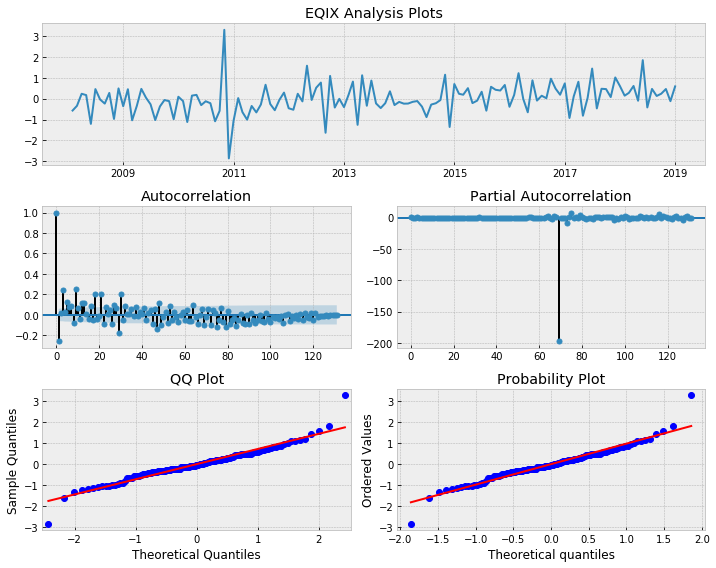

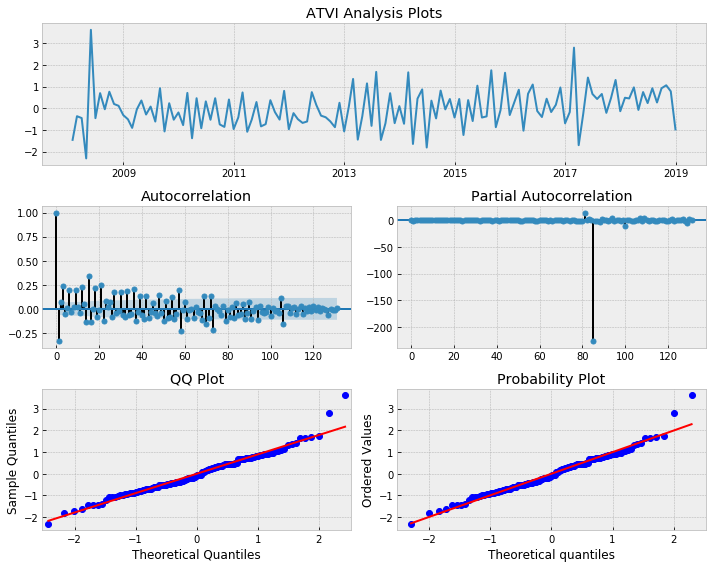

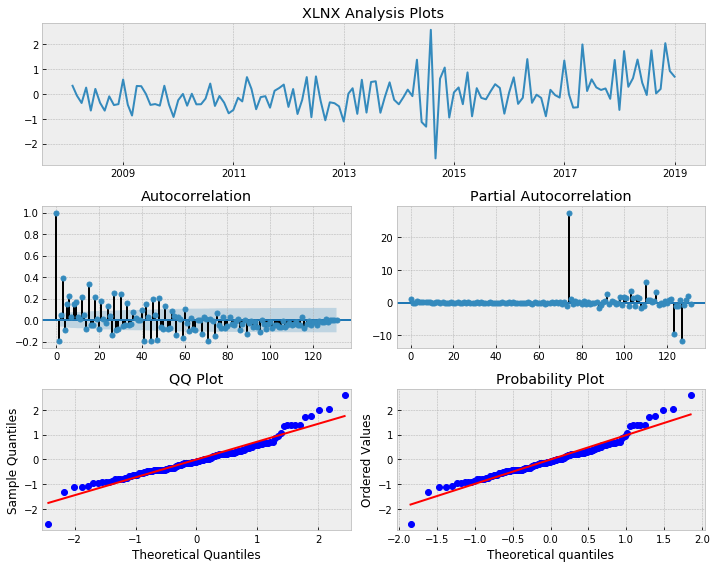

...

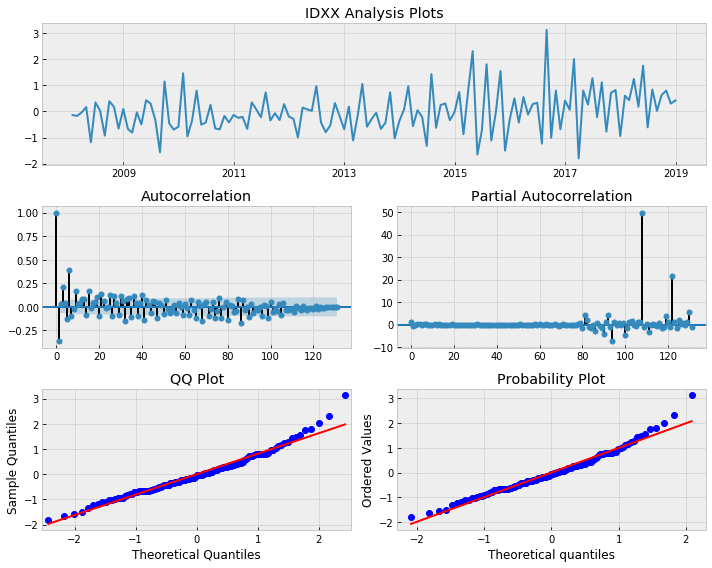

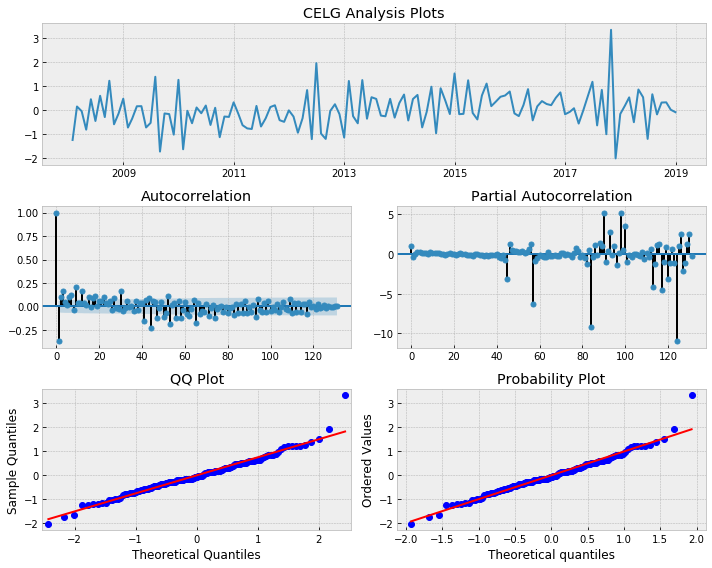

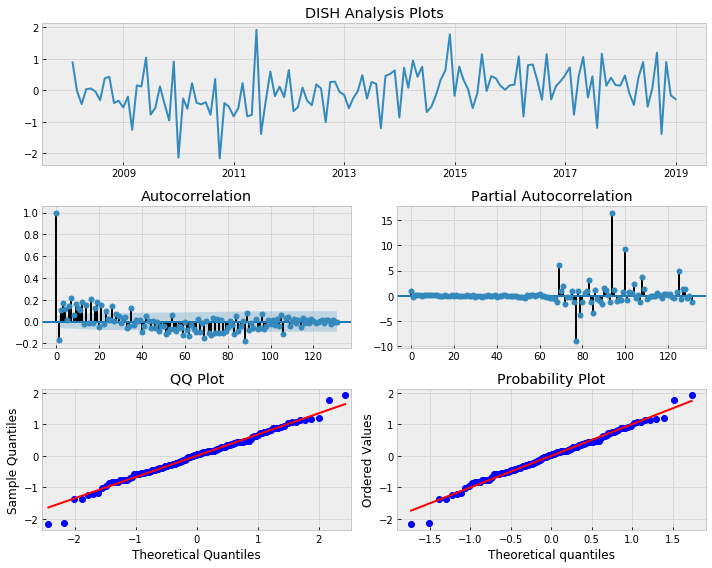

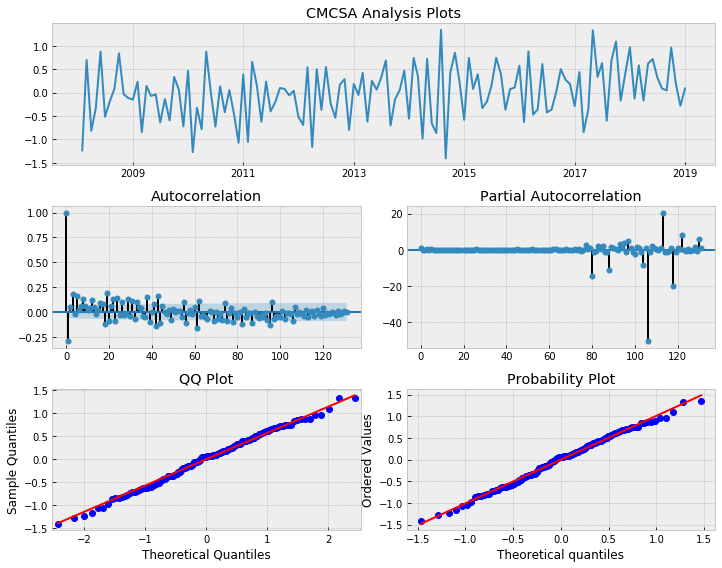

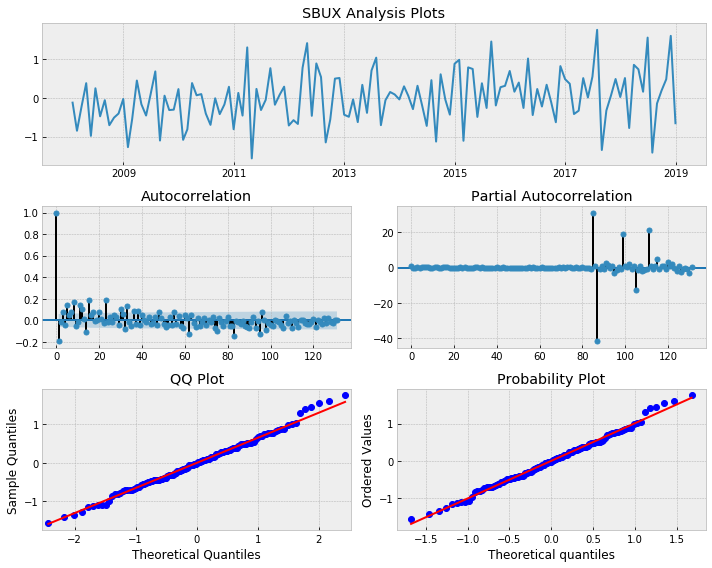

C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


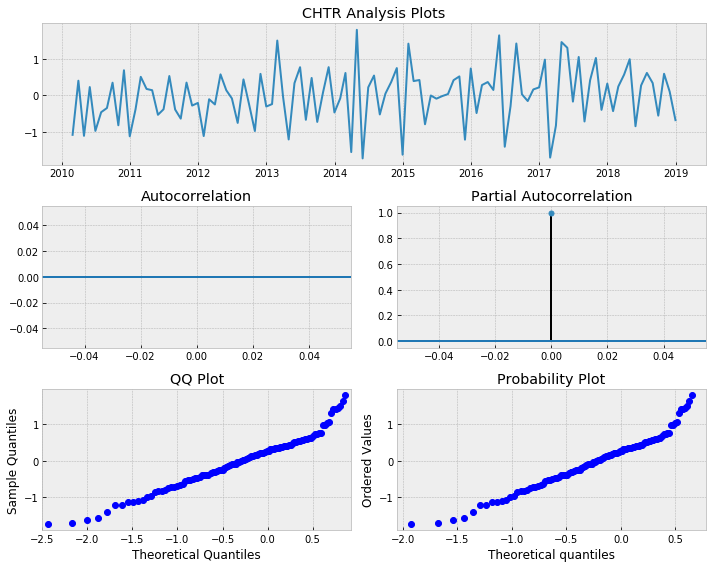

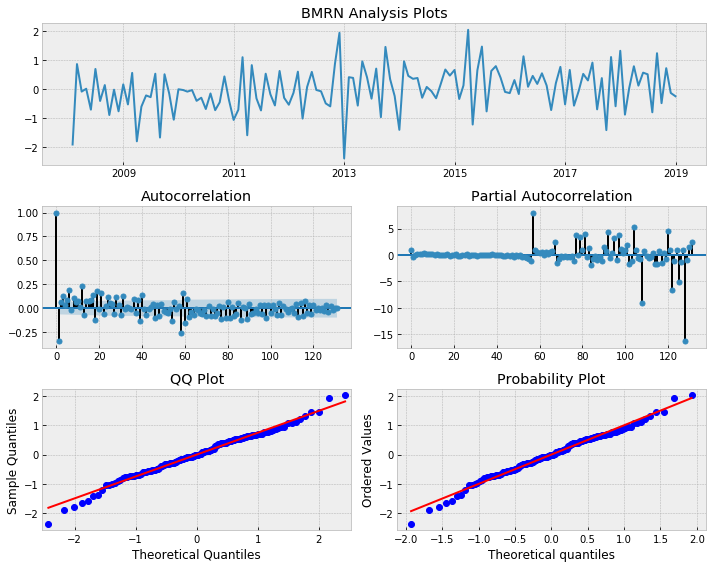

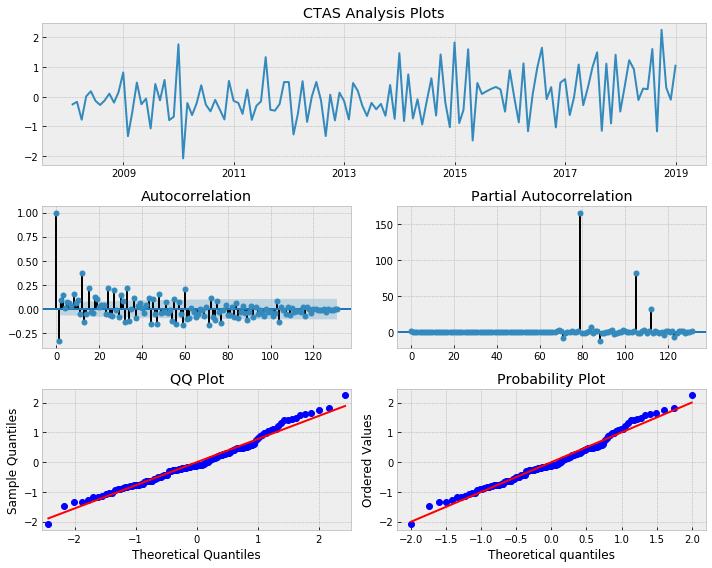

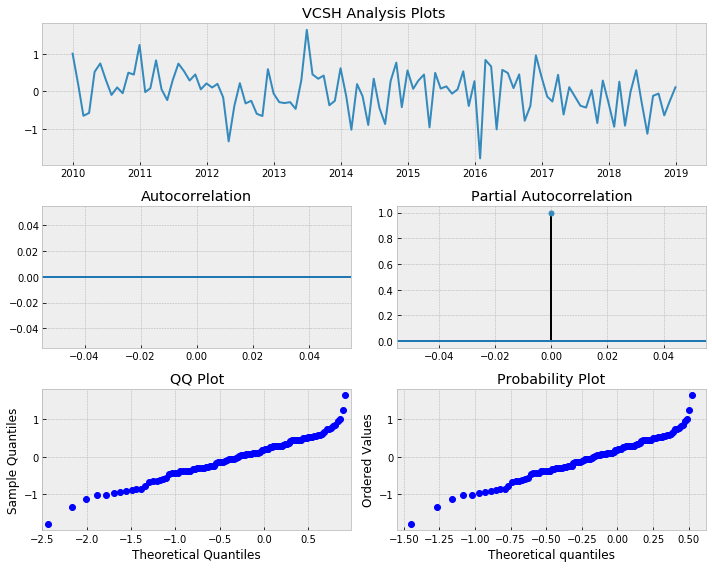

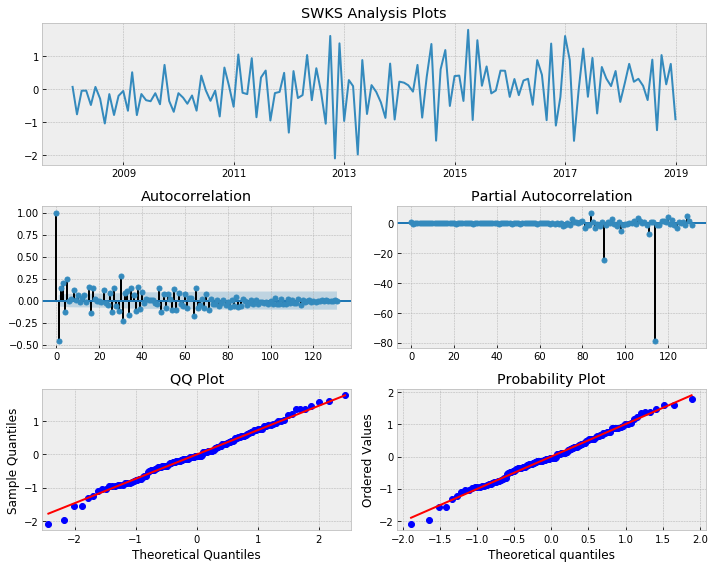

...

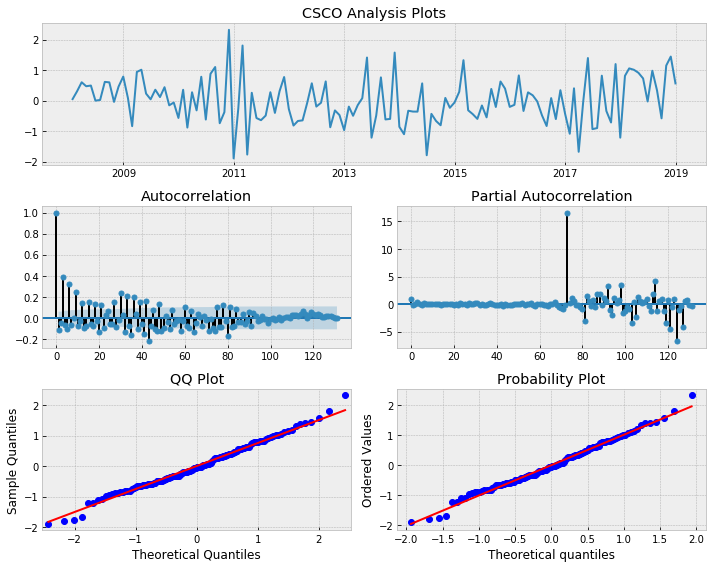

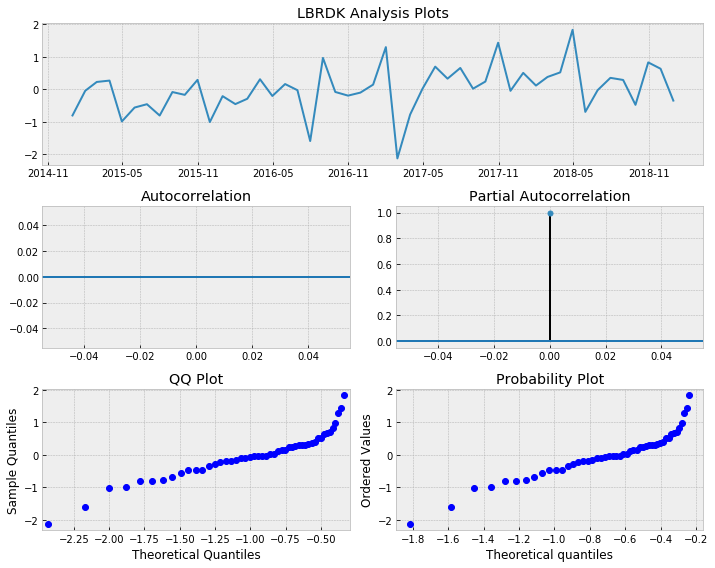

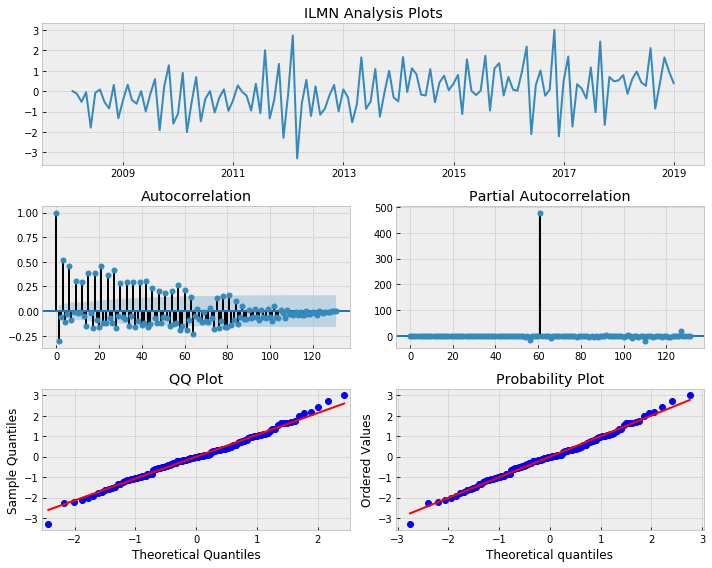

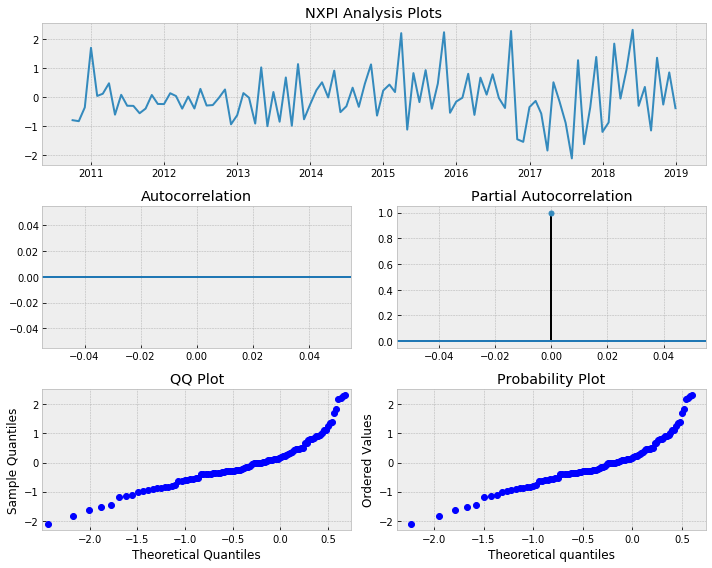

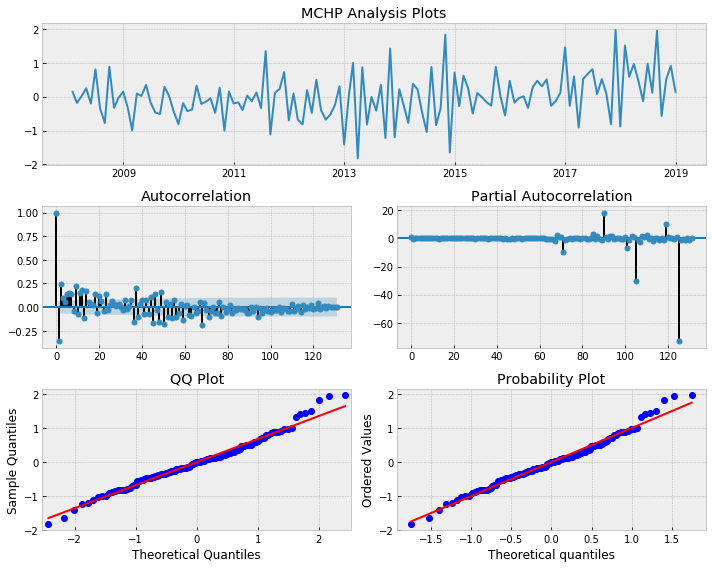

In [30]:
residuals_T = residuals.pivot(columns='Ticker', values='resid', index = 'Date').reset_index()

keys = list(set(series.keys()) - set(['SPY']))
for i in keys:
    tsplot(y = residuals_T[i], title = i, time_id = residuals_T['Date'])
    plt.show()

In [31]:
cols = list(parameters.columns)
cols.remove('Ticker')
df_all = pd.merge(parameters, pvalues, on='Ticker').set_index('Ticker')

def preparar_tabla(x):
    for c in cols:
        if x[c+'_y'] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{***}$"
        elif x[c+'_y'] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{**}$"
        elif x[c+'_y'] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c+'_x'])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c+'_x']))
            
    return(x)

df_all = df_all.apply(preparar_tabla, axis = 1)[cols].reset_index()
df_all['R_sqr'] = df_all['Ticker'].map(r_squared_adj).round(decimals = 2)
df_all['AIC'] = df_all['Ticker'].map(aic_all).round(decimals = 2)
df_all

,Ticker,const,market_info,SPY,RV_1,R_sqr,AIC
0,AAL,0.29$^{***}$,0.784$^{***}$,-0.449,0.835$^{***}$,0.71,265.43
1,AAPL,0.681$^{***}$,1.67$^{***}$,-0.272,0.788$^{***}$,0.67,301.84
2,ADBE,0.593$^{***}$,1.52$^{***}$,-2.84$^{*}$,0.809$^{***}$,0.68,320.27
3,ADI,0.839$^{***}$,0.918$^{***}$,-1.6,0.649$^{***}$,0.45,259.02
4,ADP,0.529$^{***}$,1.8$^{***}$,-2.2$^{*}$,0.768$^{***}$,0.66,254.36
5,ADSK,0.924$^{***}$,1.18$^{***}$,-1.54,0.692$^{***}$,0.49,321.35
6,ALXN,0.469$^{***}$,0.927$^{***}$,-3.53$^{**}$,0.889$^{***}$,0.81,307.47
7,AMAT,0.17$^{**}$,0.721$^{***}$,-2.92$^{**}$,0.839$^{***}$,0.72,256.47
8,AMGN,0.914$^{***}$,1.56$^{***}$,-3.89$^{***}$,0.755$^{***}$,0.64,290.13
9,AMOV,0.464$^{***}$,0.886$^{***}$,-1.8,0.572$^{***}$,0.35,270.12


88.00% of companies with a negative and significant effect


C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
C:\Users\jaime\AppData\Local\Continuum\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "
No handles with labels found to put in legend.


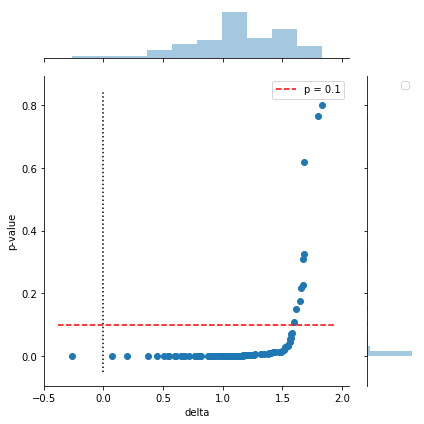

In [32]:
#########################################
# Plot final effects
#########################################
# Get points
x = parameters[parameters.market_info > -5].sort_values(by = ['market_info']).market_info
y = pvalues[parameters.market_info > -5].sort_values(by = ['market_info']).market_info
# Coverage
per = np.sum((x>0)&(y<0.1))
print('{0:.2f}% of companies with a negative and significant effect'.format(per))
# plot
h = sns.jointplot(x,y)
# plot extra lines
x0, x1 = h.ax_joint.get_xlim()
y0, y1 = h.ax_joint.get_ylim()
h.ax_joint.plot([0,0], [y0,y1], ':k')  
phantom, = h.ax_joint.plot([x0, x1], [0.1,0.1], '--r', label = 'p = 0.1')  

# legend 
h.ax_joint.legend([phantom],['p = 0.1'])

h.ax_joint.set_xlabel('delta')
h.ax_joint.set_ylabel('p-value')
plt.tight_layout()
plt.legend()
plt.show()

In [33]:
df_all.to_csv('./data/ARDL_parameters.csv')

## Fixed effects model

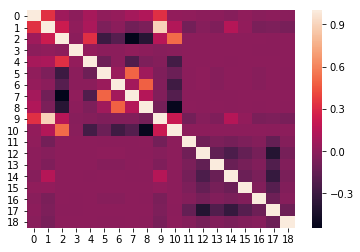

In [41]:
sns.heatmap(df.corr().values)

In [69]:
from linearmodels import PanelOLS

#######################
# Fixed effect model
#######################
# Read
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date'])

# Create dummies
sector_names = list(df.sector.unique())
df = pd.concat([df.drop(columns = ['SVI']), pd.get_dummies(df['sector'], drop_first=False).multiply(df['SVI'],axis=0)], axis=1)

# Prepare fixed time and entity effects
df.set_index(['Ticker','Date'], inplace=True)
# Model
y = df['RV']
var = ['market_info','SPY','RV_1'] +  list(pd.get_dummies(df['sector'], drop_first=False).columns)
X = sm.add_constant(df[var])
# X = df[var]
model = PanelOLS(y, X, entity_effects=False)
result = model.fit()
result.summary

Dep. Variable:,RV,R-squared:,0.8215
Estimator:,PanelOLS,R-squared (Between):,0.9895
No. Observations:,12344,R-squared (Within):,0.5497
Date:,"Mon, Aug 19 2019",R-squared (Overall):,0.8215
Time:,21:04:39,Log-likelihood,-1.554e+04
Cov. Estimator:,Unadjusted,,
,,F-statistic:,4729.2
Entities:,99,P-value,0.0000
Avg Obs:,124.69,Distribution:,"F(12,12331)"
Min Obs:,33.000,,
Max Obs:,132.00,F-statistic (robust):,4729.2


## GARCH Model

Earlier contributions in the literature (Kalev et al., 2004;
Bomfim, 2001, inter alia) https://www.sciencedirect.com/science/article/pii/S0378426603001262 suggest the use of GARCH (Engle, 1982;
Bollerslev, 1986) http://www.jstor.org/stable/1912773?casa_token=u70jYdYfQiYAAAAA:SW-edrtQyiFR4KifaoqS-ArpjLued8DA3n4JhtqN8HWgbyTq_9jkKpyKkKVy2BHLVo4ZZkyNbdwn5vECozBBh5Jztg1N6q2ALW_c8KwYYAEp67IX&seq=1#page_scan_tab_contents models for approximating historical volatility.

Although this approach can be expected to be less accurate than
the realized volatility used previously, since the latter utilizes
much more data, it has the advantage of being able to model the
conditional mean and variance at the same time in a straightforward
manner. Moreover, a wealth of empirical evidence exists on
the application of GARCH models in finance. We model conditional
volatility through the use of a GARCH(1,1) market model that includes
information demand and supply variables in the conditional
variance specification: 

\begin{align}
    r_t = \mu + \lambda\nu_t + \epsilon_t,\hspace{0.5pt}\epsilon_t | \Omega_{t-1} \approx N(o,\sigma^2_t)\\
    \sigma^2_t = w + \alpha\epsilon^2_{t-1} + \beta\sigma^2_{t-1} + \gamma\pi_t + \delta\phi_t +  \eta\tau_t
\end{align}

where $r_t$ is the stock's logarithmic return at interval $t$, $\mu$ is a constant, $\epsilon_t$ are the serially uncorrelated errors of stock returns with mean zero, $\Omega_{t-1}$
denotes the information set, $\sigma^2_t$
is the conditional variance of $\epsilon_t$,
whereas $\pi_t$ and $\phi_t$ are defined as previously.

Just in case... https://www.upwork.com/job/GARCH-Model-with-exogenous-variables-using_~01c6135cca562fdf5e/

http://www.unstarched.net/r-examples/rugarch/a-short-introduction-to-the-rugarch-package/


papers: 

Heteroskedasticity in Stock Return Data: Volume versus GARCH Effects https://onlinelibrary.wiley.com/doi/full/10.1111/j.1540-6261.1990.tb05088.x

Book: Analysis of Financial Time Series, Third Edition

In [ ]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df = df[['Date','Ticker','ret']]
df.head()

In [ ]:
df_T = df.pivot(columns='Ticker', values='ret', index = 'Date').reset_index()

keys = set(series.keys()) - set(['SPY'])
npoints = 300

for i in keys:
    tsplot(y = df_T[i].tail(npoints), title = i, time_id = df_T.tail(npoints)['Date'])
    plt.show()

We first adjust an ARIMA model, but it is not significant. Just in 9 cases the intercept is significant at a $10\%$

In [ ]:
df_arima = df

# Filter by taking residuals of MA(1)
resid_df = pd.DataFrame()
parameters = pd.DataFrame()

for t, df_grouped in df_arima.groupby('Ticker'):
    
    df_grouped = df_grouped.sort_values(by = 'Date').set_index('Date')
    
    model = am.ARIMA(df_grouped.drop(columns = 'Ticker'),
                     order = (1,0,0))
    result = model.fit(trend = 'c')
    # Keep residuals
    df_aux = pd.DataFrame(result.resid)
    resid_df = pd.concat([resid_df, df_aux], axis = 0)
    # Get model coeficients
    df_aux = pd.DataFrame([[t, result.params[0], result.pvalues[0]]], columns = ['Ticker','Coef','Pvalue'])
    parameters = pd.concat([parameters, df_aux])
    
parameters.sort_values(by = 'Pvalue')

We may test for autocorrelations in the residuas, which are the returns themselves squared. In many cases, we reject the null of no autocorrelation, so an ARCH model will be fitted. 

In [ ]:
def Durbin_Watson(x):
    return(durbin_watson(x))

def Ljung_Box(x):
    return(np.min(acorr_ljungbox(x, lags = 24)[1]))

def E_test(x):
    return(het_arch(x)[1])

df['res'] = df.groupby(['Ticker']).transform(lambda x: (x - np.mean(x - x.shift(1)))**2)
WN_df = df
WN_df = WN_df.drop(columns = 'Date').groupby('Ticker').aggregate([Durbin_Watson,Ljung_Box,E_test])
WN_df = WN_df.round(decimals = 2)['res'].reset_index().sort_values(by = 'Ljung_Box')
WN_df

In [ ]:
WN_df.to_csv('./data/ARCH_effects.csv')

Before performing the GARCH model, we have to select those firms (21) that do show aoutorrelation in their residuals. 

In [ ]:
df_garch = WN_df
df_garch = df_garch[df_garch.Ljung_Box <= 0.10]
df_garch

In [ ]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df_garch = df[df.Ticker.isin(list(df_garch['Ticker'].unique()))]
df_garch.to_csv('./data/GARCH_model.csv')

### Back from R

The model was estimated in R, and was finally an E-GARCH model. Parameters of the model are the following. 

In [ ]:
df = pd.read_csv('./data/GARCH_results.csv').drop(columns = ['p_skew','p_shape','skew','shape'])

cd = dict({'Unnamed: 0':'Ticker',})
df = df.rename(index = str, columns = cd)
df.sort_values(by = 'vxreg1')

In [ ]:
cols = ['mu','archm','omega','alpha1','beta1','gamma1','vxreg1']

def preparar_tabla(x):
    for c in cols:
        if x['p_'+c] < 0.01:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{***}$"
        elif x['p_'+c] < 0.05:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{**}$"
        elif x['p_'+c] < 0.1:
            x[c] = str('{0:.3g}'.format(x[c])) + "$^{*}$"
        else:
            x[c] = str('{0:.3g}'.format(x[c]))
            
    return(x)

df_parameters = df.apply(preparar_tabla, axis = 1)[cols + ['Ticker']].reset_index()
df_parameters

In [ ]:
df_parameters.to_csv('./data/GARCH_parameters.csv')

## VAR model

This model is not implemented in the bibliography, but it could lead to interesting results, given that we have two interactions really:

- Information demand affects volatility:
  Prior to trading their stocks, agents acquire information in order to optimize their trading strategy. Periods where the information demand grows should preceed periods with high volume of trade and thus high level of volatility. 
  
- Volatility affects information demand: 
  When volatility in the market rises, a risk averse agent would tend to 
  acquire the maximum quantity of information that is available. Then, periods with high volatility should preceed periods where the level of information demand is higher. 
  
In this set-up, it makes sense to model the two variables with a $VAR$ model. 
 

In [ ]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df.head()

In [ ]:
# Select variables for the VAR
var_data = df[['Date', 'RV', 'SVI','Ticker','SPY','market_info','ret']]
var_data = var_data.set_index('Date')

pvalues_RV = pd.DataFrame()
parameters_RV = pd.DataFrame()
pvalues_SVI = pd.DataFrame()
parameters_SVI = pd.DataFrame()

results_dict = dict()

for t, data in var_data.groupby('Ticker'):
    
    endog = ['RV','market_info']
    var = endog 
    data_endog = data[endog].dropna()
    
    model = VAR(data_endog)
    # Fit model
    results = model.fit(maxlags=5, ic='bic',trend='c')
    results_dict[t] = results
    # Get model coeficients
    

### Granger Causality test

One is often interested in whether a variable or group of variables is “causal” for another variable, for some definition of “causal”. In the context of VAR models, one can say that a set of variables are Granger-causal within one of the VAR equations. 

https://en.wikipedia.org/wiki/Granger_causality


In [ ]:
results_dict['AAPL'].test_causality('RV',['market_info'],signif=0.1).summary()

In [ ]:
for k in results_dict.keys():
    print(k,'\n')
    print(results_dict[k].test_causality('RV',['market_info'],signif=0.1).summary())

Analyse the VAR model for one time series. We pick the one for the Dow Jones index. 

In [ ]:
results_dict[k].test_normality()

In [ ]:
for k in results_dict.keys():
    print('################################''\n')
    print(k,'\n')
    print('################################''\n')

    a = results_dict[k].test_normality().summary()
    print(a ,'\n')

### Impulse Response Analysis
Impulse responses are of interest in econometric studies: they are the estimated responses to a unit impulse in one of the variables. They are computed in practice using the MA($\infty$) representation of the VAR(p) process:
\begin{equation}
Y_t = \mu + \sum_{i=0}^\infty \Phi_i u_{t-i}
\end{equation}


In [ ]:
for k in results_dict.keys():
    
    # Plot IRAnalysis
    print(k,'\n')
    # Calculate impulse response analysis
    irf = results_dict[k].irf(30)
    # Plot
    irf.plot(orth=False)
    plt.show()

In [ ]:
for k in results_dict.keys():
    
    results_dict[k].resid.plot()
    plt.show()

### Cumulative effects

The cumulative effects $\Psi_n = \sum_{i=0}^n \Phi_i$ can be plotted with the long run effects as follows:

In [ ]:
cumulative = pd.DataFrame()
try:
    endog.remove('RV')
except:
    pass

for k in results_dict.keys():
    aux = pd.DataFrame([[k] + list(results_dict[k].long_run_effects()[0,1:])], columns = ['Ticker'] + endog)
    cumulative = pd.concat([cumulative, aux])
    
print(cumulative.sort_values(by = 'market_info').mean())
cumulative.sort_values(by = 'market_info')

In [ ]:
for k in results_dict.keys():
    # Calculate impulse response analysis
    print(k,'\n')
    irf = results_dict[k].irf(30)
    irf.plot_cum_effects(orth=False)
    plt.show()

## EXOG-VAR in difference model

In [ ]:
df = pd.read_csv('./data/regresion.csv', infer_datetime_format=True, parse_dates=['Date']).drop(columns = 'Unnamed: 0')
df = df[(df.Date.dt.year > 2010) & (df.Date.dt.year < 2018)]
# Select variables for the VAR
var_data = df[['Date','Ticker','RV','SVI','ret','SPY','market_info']]
var_data = var_data.set_index('Date')

class mi_varmax_model:
    
    def __init__(self,data):
        self.data = data
        
    def train_model(self, trend='c', error_cov_type='diagonal', enforce_invertibility=True, maxlags = 5, ic='bic', cov_type='robust'):
        
        ''' Train model '''
        
        from statsmodels.tsa.api import VARMAX 
        
        self.pvalues = pd.DataFrame()
        self.parameters = pd.DataFrame()
        self.results_dict = dict()

        print('Training...')
            
        for t, data in self.data.groupby('Ticker'):
            
            endog = ['RV','SVI']
            endog = data[endog].dropna()
            exog = ['SPY','market_info']
            exog = data[exog].dropna()
            # Especify model
            self.model = VARMAX(endog.values, 
                           trend=trend, 
                           exog=exog.values, 
                           error_cov_type=error_cov_type,
                           enforce_invertibility=enforce_invertibility)
            # Fit model
            results = self.model.fit(maxiter=3000, maxlags = 5, ic='bic', cov_type='robust')
            self.results_dict[t] = results
            # Get model coeficients
            df_coef = pd.DataFrame(results.params).T
            df_coef['Ticker'] = t
            self.parameters = pd.concat([self.parameters, df_coef])

            # Get model pvalues
            df_pvals = pd.DataFrame(results.pvalues).T
            df_pvals['Ticker'] = t
            self.pvalues = pd.concat([self.pvalues, df_pvals])   
            
    def mean_cumulative_response(self):
        
        cum_res = 0
        for k in results_dict.keys():
            cum_res += self.results_dict[k].impulse_responses(30, cumulative=True)[-1:,1]

        return(cum_res/len(results_dict))
    
    def mean_heteroskedasticity_test(self):
        
        ''' Mean future cumulative response:
            The null hypothesis is of no heteroskedasticity in the residuals. '''
        
        mean_p = 0
        for k in results_dict.keys():
            mean_p += self.results_dict[k].test_heteroskedasticity(method=None)[:,1].mean()

        return(mean_p/len(self.results_dict))
    
    def mean_normality_test(self):
        
        ''' Test for normality in the residuals 
            Null hypothesis is normality of the residuals. '''
        mean_p = 0
        for k in results_dict.keys():
            mean_p += self.results_dict[k].test_normality(method = 'jarquebera')[:,1].mean()

        return(mean_p/len(self.results_dict))
        


In [ ]:
search_grid = {'error_cov_type':['diagonal'],
               'enforce_invertibility':[True],
               'ic':['bic'],
               'cov_type':['robust','opg','approx',None]}
var_results = pd.DataFrame()

instance = mi_varmax_model(data = var_data)

for ct in search_grid['cov_type']:
    for ei in search_grid['enforce_invertibility']:
        for ic in search_grid['ic']:
            instance.train_model(cov_type = ect,enforce_invertibility=ei,ic = ic )
            cr = instance.mean_cumulative_response()
            ht = instance.mean_heteroskedasticity_test()
            nt = instance.mean_normality_test()
            
            aux = pd.DataFrame({
                                'ct':ect,
                                'ei':ei,
                                'ic':ic,
                                'cr':cr,
                                'ht':ht,
                                'nt':nt})
            
            var_results = pd.concat([var_results, aux])
            
var_results       